In [1]:
import os
import sys
import json
import datetime
import numpy as np
import skimage.io
from imgaug import augmenters as iaa

# Root directory of the project
ROOT_DIR = os.path.abspath("F:/BFL/Mask_RCNN-master-tf1/Mask_RCNN-master/")
print(ROOT_DIR)
# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
from mrcnn import model as modellib
from mrcnn import visualize

F:\BFL\Mask_RCNN-master-tf1\Mask_RCNN-master


C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\tensorflow\python\framework\dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\tensorflow\python\framework\dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\tensorflow\python\framework\dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\tensorflow\pyth

In [2]:
import tensorflow as tf
print(tf.test.is_gpu_available())
from tensorflow.python.client import device_lib

# Get list of all available devices
local_devices = device_lib.list_local_devices()

# Filter out GPUs
gpu_devices = [device.name for device in local_devices if device.device_type == 'GPU']

if gpu_devices:
    for gpu in gpu_devices:
        print("GPU available:", gpu)
else:
    print("No GPU available.")


True
GPU available: /device:GPU:0


In [3]:
# Path to trained weights file
COCO_WEIGHTS_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Directory to save logs and model checkpoints, if not provided
# through the command line argument --logs
DEFAULT_LOGS_DIR = os.path.join(ROOT_DIR, "logs")

RESULTS_DIR = os.path.join(ROOT_DIR, "results/bfl/")

In [4]:
class BFLConfig(Config):
    """Configuration for training on the nucleus segmentation dataset."""
    # Give the configuration a recognizable name
    NAME = "bfl"

    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 6  # background + 3 shapes

    # Use small images for faster training. Set the limits of the small side
    # the large side, and that determines the image shape.
    IMAGE_RESIZE_MODE = "square"
    IMAGE_MIN_DIM = 768
    IMAGE_MAX_DIM = 768
    
    BACKBONE_STRIDES = [4, 8, 16, 32, 64]
    BATCH_SIZE = 1
    IMAGE_RESIZE_MODE = "square"
    IMAGE_MIN_DIM = 768
    IMAGE_MAX_DIM = 768
    IMAGE_CHANNEL_COUNT = 3
    NUM_CLASSES = 1 + 6  # background + 6 types of defects
    RPN_ANCHOR_SCALES = (4, 8, 16, 32, 64)  # Adjusted for smaller defects
    RPN_ANCHOR_RATIOS = [0.1, 0.3, 0.5, 1, 2]  # Adjusted for elongated defects
    RPN_NMS_THRESHOLD = 0.6
    TRAIN_ROIS_PER_IMAGE = 256  # Increased for more training samples
    DETECTION_MIN_CONFIDENCE = 0.5  # Lowered to catch more defects
    DETECTION_NMS_THRESHOLD = 0.2  # Lowered for better defect detection
   
    LEARNING_RATE = 0.001
    LEARNING_MOMENTUM = 0.9
    WEIGHT_DECAY = 0.0001
    USE_MINI_MASK = True
    MINI_MASK_SHAPE = (56, 56)
    MAX_GT_INSTANCES = 100
    DETECTION_MAX_INSTANCES = 100
    
    # Use a small epoch since the data is simple
    STEPS_PER_EPOCH = (136) // IMAGES_PER_GPU
    VALIDATION_STEPS = max(1, 32 )// IMAGES_PER_GPU



class BFLInferenceConfig(BFLConfig):
    # Set batch size to 1 to run one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    # Don't resize imager for inferencing
    IMAGE_RESIZE_MODE = "square"
    # Non-max suppression threshold to filter RPN proposals.
    # You can increase this during training to generate more propsals.
    RPN_NMS_THRESHOLD = 0.7


In [5]:
class BFLDataset(utils.Dataset):

    def load_images(self, dataset_dir, subset):
        """Load a subset of the nuclei dataset.

        dataset_dir: Root directory of the dataset
        subset: Subset to load. Either the name of the sub-directory,
                such as stage1_train, stage1_test, ...etc. or, one of:
                * train: stage1_train excluding validation images
                * val: validation images from VAL_IMAGE_IDS
        """
        # Add classes. We have one class.
        # Naming the dataset nucleus, and the class nucleus
        class_names = ["Dent-marks","Fingerprints-and-stains","Jig-Marks","Machining-Marks","No-sharp-edge","Scratches"]
#         self.add_class("bfl", 1, "defect")
        for i, class_name in enumerate(class_names, 1):
            self.add_class("bfl", i, class_name)
        
        assert subset in ["train", "val"]
        
        if subset == 'train':
            for root, dirs, files in os.walk(dataset_dir):
                for file_name in files:
                    image_path = os.path.join(dataset_dir, file_name)
                    self.add_image(
                    "bfl",
                    image_id=file_name,  # use file name as a unique image id
                    path=image_path)
                    
        if subset == 'val':
            for root, dirs, files in os.walk(dataset_dir):
                for file_name in files:
                    image_path = os.path.join(dataset_dir, file_name)
                    self.add_image(
                    "bfl",
                    image_id=file_name,  # use file name as a unique image id
                    path=image_path)

        # Add images
#         for image_id in image_ids:
#             self.add_image(
#                 "bfl",
#                 image_id=image_id,
#                 path=os.path.join(dataset_dir, image_id, "images/{}.png".format(image_id)))

    def load_image(self, image_id):
        """Generate an image from the specs of the given image ID.
        Typically this function loads the image from a file, but
        in this case it generates the image on the fly from the
        specs in image_info.
        """
        info = self.image_info[image_id]
        image_path=info['path']
        image = cv2.imread(image_path)
        # print(image_path)
        # If the image could not be read, return None
        if image is None:
            print(f"Error: Unable to read the image at {image_path}")
            return None
    
        # Convert the image to RGB (OpenCV uses BGR by default)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Get the height, width, and number of channels of the image
        height, width, _ = image_rgb.shape

        return image_rgb
        

    def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        info = self.image_info[image_id]
        # print(info)
        # Get mask directory from image path
        mask_dir = "E:/base/masks/"
#         print(image_id)
        # Read mask files from .png image
        masks = []
        class_ids = []
        for root, dirs, files in os.walk(mask_dir):
            for f in files:
                if f.endswith(".png"):
                    num, mask_image_id, annot_id, category_id, __ = f.split('_')
                    # Only add the mask if it corresponds to the current image
#                     print(mask_image_id)
                    # print(num+"_"+mask_image_id+'.jpg')
#                     print(info['id'])
                    if ((num+"_"+mask_image_id+'.jpg') == info['id']):
                        # print(mask_image_id)
                        m = skimage.io.imread(os.path.join(mask_dir, f)).astype(np.bool)
                        masks.append(m)
                        class_ids.append(category_id)
        if masks:
            masks = np.stack(masks, axis=-1)
            class_ids = np.array(class_ids, dtype=np.int32)
            return masks, class_ids
        else:
            # Return empty masks and class_ids if no masks are found for the image
            return np.empty((0, 0, 0), dtype=np.bool), np.empty((0,), dtype=np.int32)

    def image_reference(self, image_id):
        """Return the path of the image."""
        info = self.image_info[image_id]
        if info["source"] == "bfl":
            return info["id"]
        else:
            super(self.__class__, self).image_reference(image_id)

In [6]:
dataset_train = BFLDataset()
dataset_train.load_images("E:/base/train/", "train")
dataset_train.prepare()

dataset_val = BFLDataset()
dataset_val.load_images("E:/base/valid/", "val")
dataset_val.prepare()


In [7]:
#image_ids = np.random.choice(dataset_train.image_ids, 4)
# for image_id in image_ids:
#     image = dataset_train.load_image(image_id)
mask, class_ids = dataset_train.load_mask(1)
# visualize.display_top_masks("", mask, class_ids, dataset_train.class_names)


In [8]:
print(dataset_train.load_mask(1))

(array([[[False, False, False, False],
        [False, False, False, False],
        [False, False, False, False],
        ...,
        [False, False, False, False],
        [False, False, False, False],
        [False, False, False, False]],

       [[False, False, False, False],
        [False, False, False, False],
        [False, False, False, False],
        ...,
        [False, False, False, False],
        [False, False, False, False],
        [False, False, False, False]],

       [[False, False, False, False],
        [False, False, False, False],
        [False, False, False, False],
        ...,
        [False, False, False, False],
        [False, False, False, False],
        [False, False, False, False]],

       ...,

       [[False, False, False, False],
        [False, False, False, False],
        [False, False, False, False],
        ...,
        [False, False, False, False],
        [False, False, False, False],
        [False, False, False, False]],

       [[False

[ 50  53   7 134]


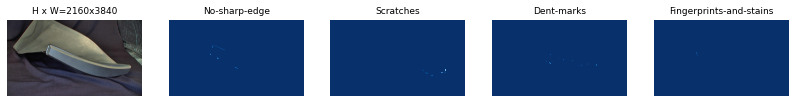

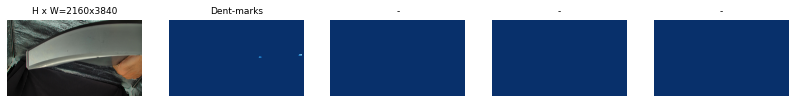

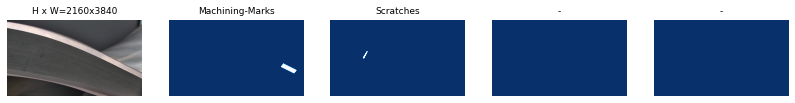

F:\BFL\Mask_RCNN-master-tf1\Mask_RCNN-master\mrcnn\visualize.py:54: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  norm=norm, interpolation=interpolation)
F:\BFL\Mask_RCNN-master-tf1\Mask_RCNN-master\mrcnn\visualize.py:54: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  norm=norm, interpolation=interpolation)


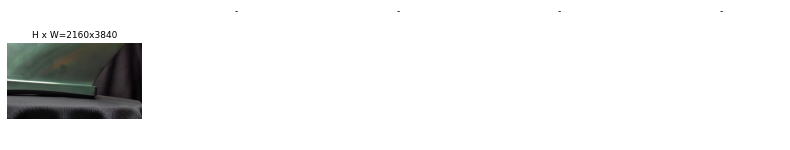

In [9]:
import cv2
image_ids = np.random.choice(dataset_train.image_ids, 4)
print(image_ids)
for image_id in image_ids:
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)


In [10]:
augmentation = iaa.SomeOf((0, 2), [
    iaa.Fliplr(0.5),
    iaa.Flipud(0.5),
    iaa.OneOf([
        iaa.Affine(rotate=90),
        iaa.Affine(rotate=180),
        iaa.Affine(rotate=270)
    ]),
    iaa.Multiply((0.8, 1.5)),
    iaa.GaussianBlur(sigma=(0.0, 5.0)),
    iaa.Affine(scale={"x": (0.6, 1.4), "y": (0.8, 1.2)})
])


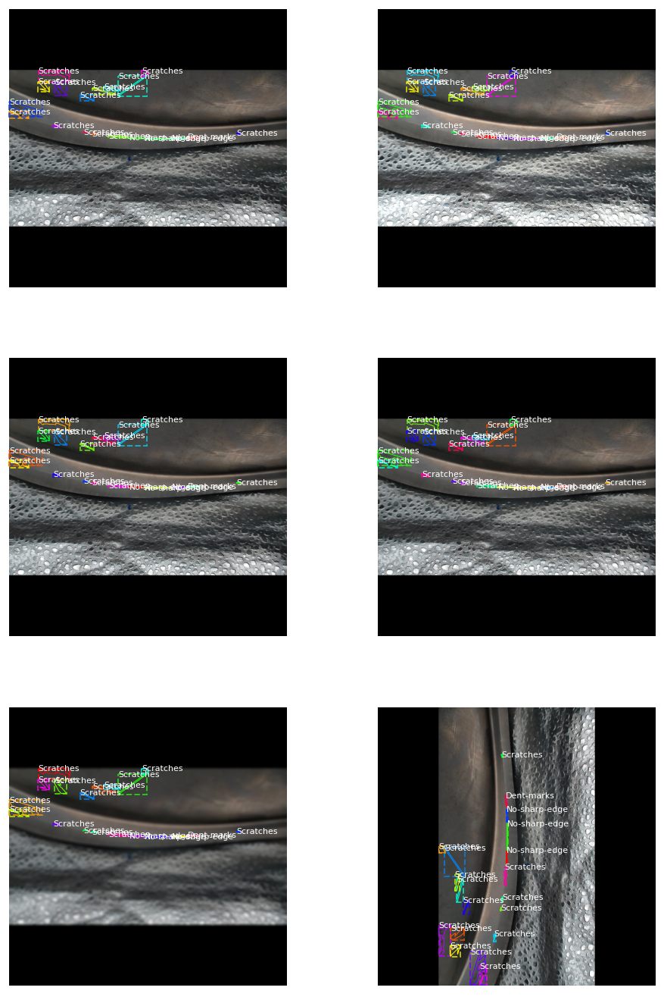

In [13]:
limit = 6
config = BFLConfig()
ax = get_ax(rows=3, cols=limit//3)
for i in range(limit):
    image, image_meta, class_ids, bbox, mask = modellib.load_image_gt(
        dataset_train, config, image_id, use_mini_mask=False, augment=False, augmentation=augmentation)
    visualize.display_instances(image, bbox, mask, class_ids,
                                dataset_train.class_names, ax=ax[i//2, i % 2],
                                show_mask=False, show_bbox=True)

In [14]:
### config = BFLConfig()
config.display()
model = modellib.MaskRCNN(mode="training", config=config,
                                  model_dir=DEFAULT_LOGS_DIR)

# model_path = os.path.join(ROOT_DIR, "mask_rcnn_coco_original.h5")
model_path = model.find_last()

# Load trained weights
print("Loading weights from ", model_path)
# model.load_weights(model_path,  exclude=[ "rpn_class_raw", "rpn_bbox_pred", "mrcnn_class_logits", "mrcnn_bbox_fc", "mrcnn_bbox", "mrcnn_mask", "rpn_model"])
model.load_weights(model_path)
model.train(dataset_train, dataset_val, 
            learning_rate=config.LEARNING_RATE,
            augmentation=augmentation,
            epochs=20,
            layers='heads')


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.5
DETECTION_NMS_THRESHOLD        0.2
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  768
IMAGE_META_SIZE                19
IMAGE_MIN_DIM                  768
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [768 768   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE             

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\tensorflow\python\ops\gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Epoch 12/20


C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or exp

  1/136 [..............................] - ETA: 57:27 - loss: 1.6461 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.8570 - mrcnn_class_loss: 0.0167 - mrcnn_bbox_loss: 0.3194 - mrcnn_mask_loss: 0.4343

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/136 [..............................] - ETA: 20:59 - loss: 2.9827 - rpn_class_loss: 0.0269 - rpn_bbox_loss: 2.4034 - mrcnn_class_loss: 0.0242 - mrcnn_bbox_loss: 0.3331 - mrcnn_mask_loss: 0.1951

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/136 [..............................] - ETA: 16:26 - loss: 2.7777 - rpn_class_loss: 0.0294 - rpn_bbox_loss: 2.1067 - mrcnn_class_loss: 0.0543 - mrcnn_bbox_loss: 0.3633 - mrcnn_mask_loss: 0.2239

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/136 [>.............................] - ETA: 13:40 - loss: 3.0135 - rpn_class_loss: 0.0401 - rpn_bbox_loss: 2.2006 - mrcnn_class_loss: 0.0615 - mrcnn_bbox_loss: 0.4623 - mrcnn_mask_loss: 0.2490

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/136 [>.............................] - ETA: 11:48 - loss: 2.8741 - rpn_class_loss: 0.0366 - rpn_bbox_loss: 1.9953 - mrcnn_class_loss: 0.0520 - mrcnn_bbox_loss: 0.5537 - mrcnn_mask_loss: 0.2365

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/136 [>.............................] - ETA: 10:29 - loss: 3.1781 - rpn_class_loss: 0.0366 - rpn_bbox_loss: 2.2362 - mrcnn_class_loss: 0.0479 - mrcnn_bbox_loss: 0.5727 - mrcnn_mask_loss: 0.2847

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/136 [>.............................] - ETA: 9:31 - loss: 3.1510 - rpn_class_loss: 0.0336 - rpn_bbox_loss: 2.1496 - mrcnn_class_loss: 0.0454 - mrcnn_bbox_loss: 0.5959 - mrcnn_mask_loss: 0.3266 

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/136 [>.............................] - ETA: 8:44 - loss: 2.8571 - rpn_class_loss: 0.0347 - rpn_bbox_loss: 1.9621 - mrcnn_class_loss: 0.0403 - mrcnn_bbox_loss: 0.5297 - mrcnn_mask_loss: 0.2903

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/136 [=>............................] - ETA: 8:06 - loss: 2.8620 - rpn_class_loss: 0.0384 - rpn_bbox_loss: 1.9331 - mrcnn_class_loss: 0.0480 - mrcnn_bbox_loss: 0.5406 - mrcnn_mask_loss: 0.3018

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/136 [=>............................] - ETA: 7:35 - loss: 2.9516 - rpn_class_loss: 0.0370 - rpn_bbox_loss: 2.0185 - mrcnn_class_loss: 0.0442 - mrcnn_bbox_loss: 0.5384 - mrcnn_mask_loss: 0.3136

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/136 [=>............................] - ETA: 7:09 - loss: 3.0627 - rpn_class_loss: 0.0366 - rpn_bbox_loss: 2.1007 - mrcnn_class_loss: 0.0453 - mrcnn_bbox_loss: 0.5463 - mrcnn_mask_loss: 0.3338

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/136 [=>............................] - ETA: 6:46 - loss: 3.2042 - rpn_class_loss: 0.0375 - rpn_bbox_loss: 2.2619 - mrcnn_class_loss: 0.0443 - mrcnn_bbox_loss: 0.5372 - mrcnn_mask_loss: 0.3232

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/136 [==>...........................] - ETA: 6:27 - loss: 3.2045 - rpn_class_loss: 0.0399 - rpn_bbox_loss: 2.3245 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.4989 - mrcnn_mask_loss: 0.3001

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/136 [==>...........................] - ETA: 5:54 - loss: 3.1309 - rpn_class_loss: 0.0392 - rpn_bbox_loss: 2.2967 - mrcnn_class_loss: 0.0364 - mrcnn_bbox_loss: 0.4853 - mrcnn_mask_loss: 0.2732

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/136 [==>...........................] - ETA: 5:41 - loss: 3.0582 - rpn_class_loss: 0.0387 - rpn_bbox_loss: 2.2056 - mrcnn_class_loss: 0.0354 - mrcnn_bbox_loss: 0.5002 - mrcnn_mask_loss: 0.2783

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/136 [===>..........................] - ETA: 5:18 - loss: 3.0112 - rpn_class_loss: 0.0370 - rpn_bbox_loss: 2.1920 - mrcnn_class_loss: 0.0336 - mrcnn_bbox_loss: 0.4682 - mrcnn_mask_loss: 0.2804

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or exp

 20/136 [===>..........................] - ETA: 5:08 - loss: 2.9871 - rpn_class_loss: 0.0384 - rpn_bbox_loss: 2.1542 - mrcnn_class_loss: 0.0356 - mrcnn_bbox_loss: 0.4764 - mrcnn_mask_loss: 0.2825

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/136 [===>..........................] - ETA: 4:59 - loss: 2.9409 - rpn_class_loss: 0.0389 - rpn_bbox_loss: 2.0940 - mrcnn_class_loss: 0.0382 - mrcnn_bbox_loss: 0.4772 - mrcnn_mask_loss: 0.2926

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or exp

 22/136 [===>..........................] - ETA: 4:53 - loss: 2.9046 - rpn_class_loss: 0.0415 - rpn_bbox_loss: 2.0532 - mrcnn_class_loss: 0.0411 - mrcnn_bbox_loss: 0.4781 - mrcnn_mask_loss: 0.2906

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/136 [====>.........................] - ETA: 4:47 - loss: 2.9206 - rpn_class_loss: 0.0404 - rpn_bbox_loss: 2.0490 - mrcnn_class_loss: 0.0402 - mrcnn_bbox_loss: 0.4991 - mrcnn_mask_loss: 0.2919

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or exp

 24/136 [====>.........................] - ETA: 4:43 - loss: 2.8840 - rpn_class_loss: 0.0397 - rpn_bbox_loss: 2.0038 - mrcnn_class_loss: 0.0389 - mrcnn_bbox_loss: 0.5171 - mrcnn_mask_loss: 0.2845

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/136 [====>.........................] - ETA: 4:36 - loss: 2.8481 - rpn_class_loss: 0.0391 - rpn_bbox_loss: 1.9635 - mrcnn_class_loss: 0.0396 - mrcnn_bbox_loss: 0.5130 - mrcnn_mask_loss: 0.2930

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/136 [====>.........................] - ETA: 4:29 - loss: 2.7673 - rpn_class_loss: 0.0383 - rpn_bbox_loss: 1.9160 - mrcnn_class_loss: 0.0381 - mrcnn_bbox_loss: 0.4933 - mrcnn_mask_loss: 0.2817

C:\Users\HP DK0045TX\.conda\envs\tf1\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/136 [==============================] - 333s 2s/step - loss: 2.9992 - rpn_class_loss: 0.0543 - rpn_bbox_loss: 2.1694 - mrcnn_class_loss: 0.0386 - mrcnn_bbox_loss: 0.4626 - mrcnn_mask_loss: 0.2742 - val_loss: 3.5805 - val_rpn_class_loss: 0.0615 - val_rpn_bbox_loss: 2.7412 - val_mrcnn_class_loss: 0.0357 - val_mrcnn_bbox_loss: 0.4845 - val_mrcnn_mask_loss: 0.2576
Epoch 13/20
136/136 [==============================] - 234s 2s/step - loss: 3.0879 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 2.2397 - mrcnn_class_loss: 0.0406 - mrcnn_bbox_loss: 0.4734 - mrcnn_mask_loss: 0.2864 - val_loss: 3.3525 - val_rpn_class_loss: 0.0541 - val_rpn_bbox_loss: 2.4565 - val_mrcnn_class_loss: 0.0416 - val_mrcnn_bbox_loss: 0.5286 - val_mrcnn_mask_loss: 0.2717
Epoch 14/20
136/136 [==============================] - 245s 2s/step - loss: 3.0882 - rpn_class_loss: 0.0478 - rpn_bbox_loss: 2.1953 - mrcnn_class_loss: 0.0481 - mrcnn_bbox_loss: 0.4747 - mrcnn_mask_loss: 0.3223 - val_loss: 3.1439 - val_rpn_class_loss: 0.05

In [1]:
!tensorboard --logdir="F://BFL/Mask_RCNN-master-tf1/Mask_RCNN-master/logs"

^C


In [14]:
class InferenceConfig(BFLConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    IMAGE_RESIZE_MODE = "square"
    IMAGE_MIN_DIM = 768
    IMAGE_MAX_DIM = 768
    DETECTION_MAX_INSTANCES=32
    DETECTION_MIN_CONFIDENCE = 0.5  # Same as training
    DETECTION_NMS_THRESHOLD = 0.2  # Same as training
    RPN_NMS_THRESHOLD = 0.6  # Same as training
    RPN_ANCHOR_SCALES = (4, 8, 16, 32, 64)  # Adjusted for smaller defects
    RPN_ANCHOR_RATIOS = [0.1, 0.3, 0.5, 1, 2]  # Adjusted for elongated defects
    
inference_config = InferenceConfig()
inference_config.display()
# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir="DEFAULT_LOGS_DIR")

# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, "/logs\bfl20240522T1921\mask_rcnn_bfl_0020.h5"")
# model_path = model.find_last()
model_path =  "F:/BFL/Mask_RCNN-master-tf1/Mask_RCNN-master/logs/bfl20240522T2305/mask_rcnn_bfl_0020.h5"
# Load trained weights
print("Loading weights from ", model_path)
model.load_weights( model_path, by_name=True)


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        32
DETECTION_MIN_CONFIDENCE       0.5
DETECTION_NMS_THRESHOLD        0.2
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  768
IMAGE_META_SIZE                19
IMAGE_MIN_DIM                  768
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [768 768   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE              

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (3,)                  min:    6.00000  max:    6.00000  int32
gt_bbox                  shape: (3, 4)                min:  128.00000  max:  567.00000  int32
gt_mask                  shape: (768, 768, 3)         min:    0.00000  max:    1.00000  bool


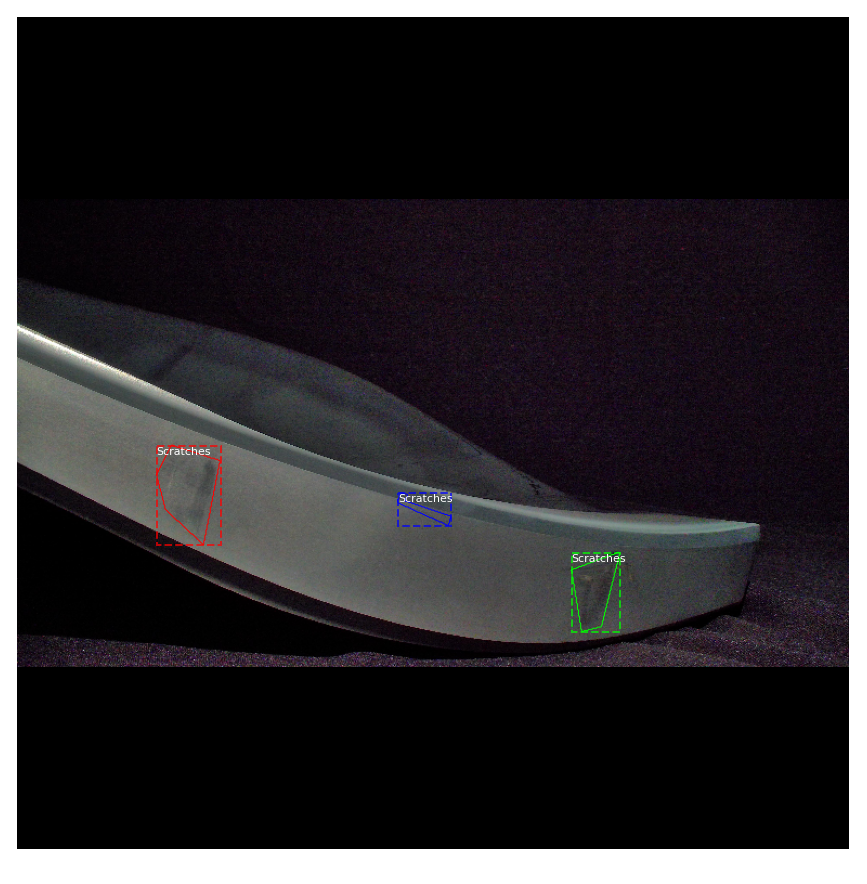

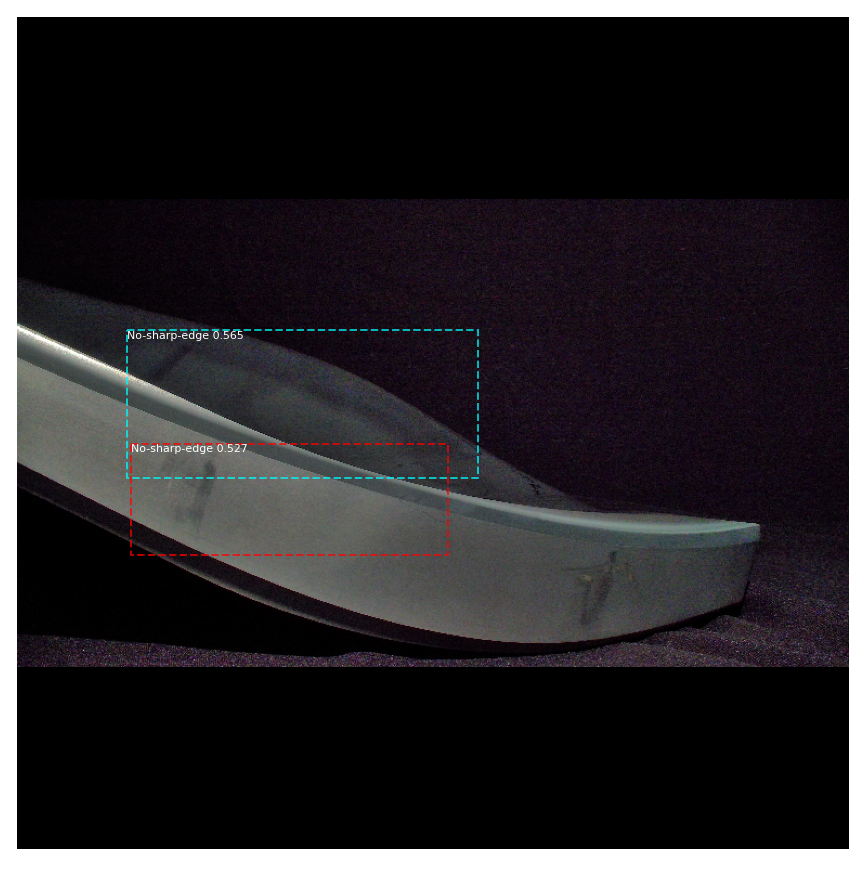

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (6,)                  min:    4.00000  max:    6.00000  int32
gt_bbox                  shape: (6, 4)                min:  215.00000  max:  553.00000  int32
gt_mask                  shape: (768, 768, 6)         min:    0.00000  max:    1.00000  bool


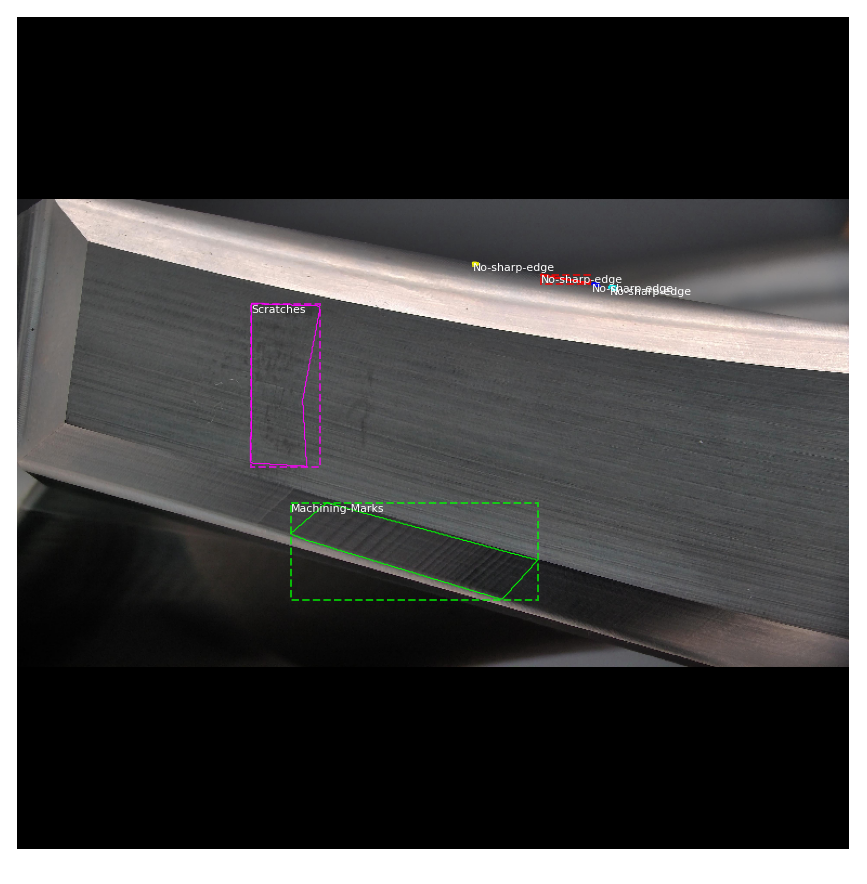

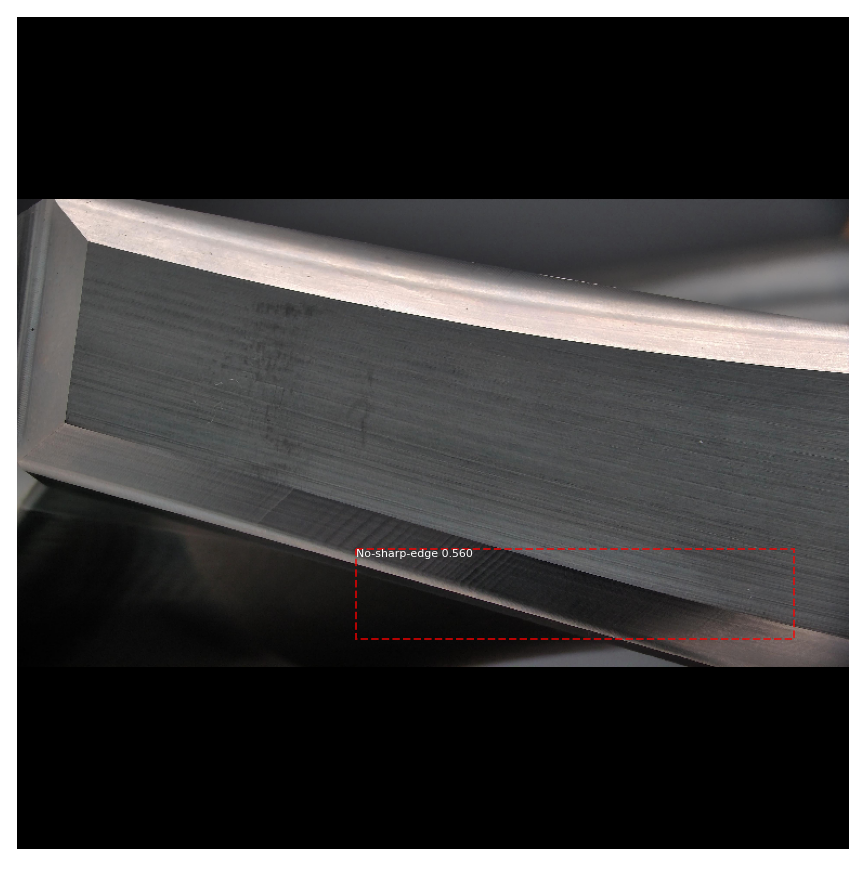

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (1,)                  min:    5.00000  max:    5.00000  int32
gt_bbox                  shape: (1, 4)                min:  406.00000  max:  483.00000  int32
gt_mask                  shape: (768, 768, 1)         min:    0.00000  max:    1.00000  bool


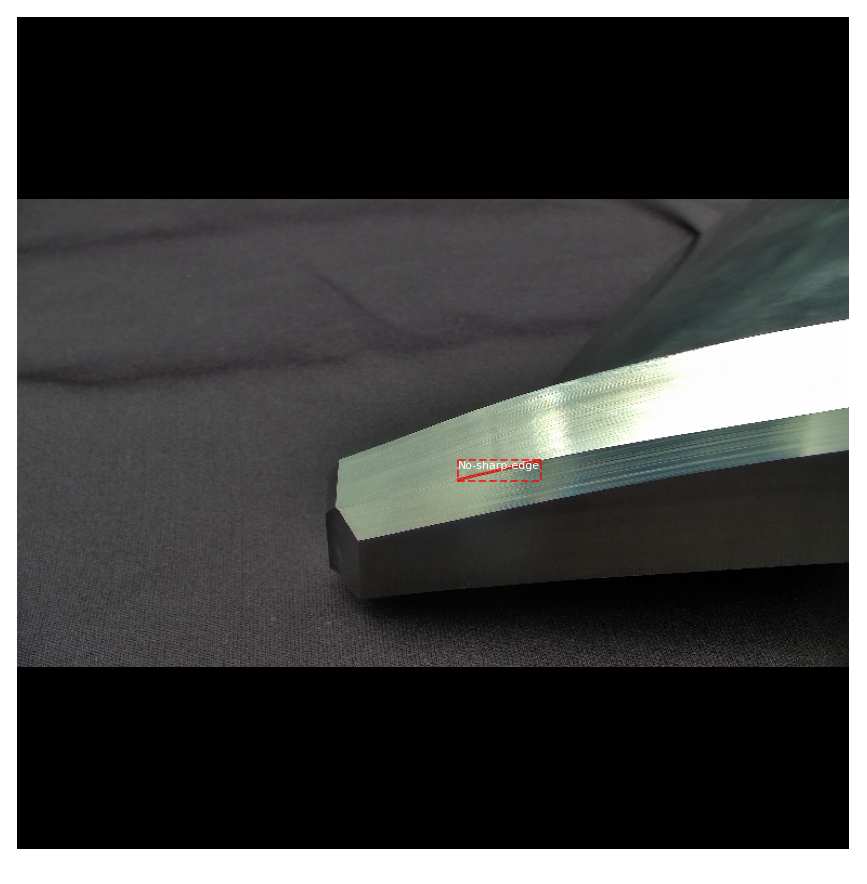

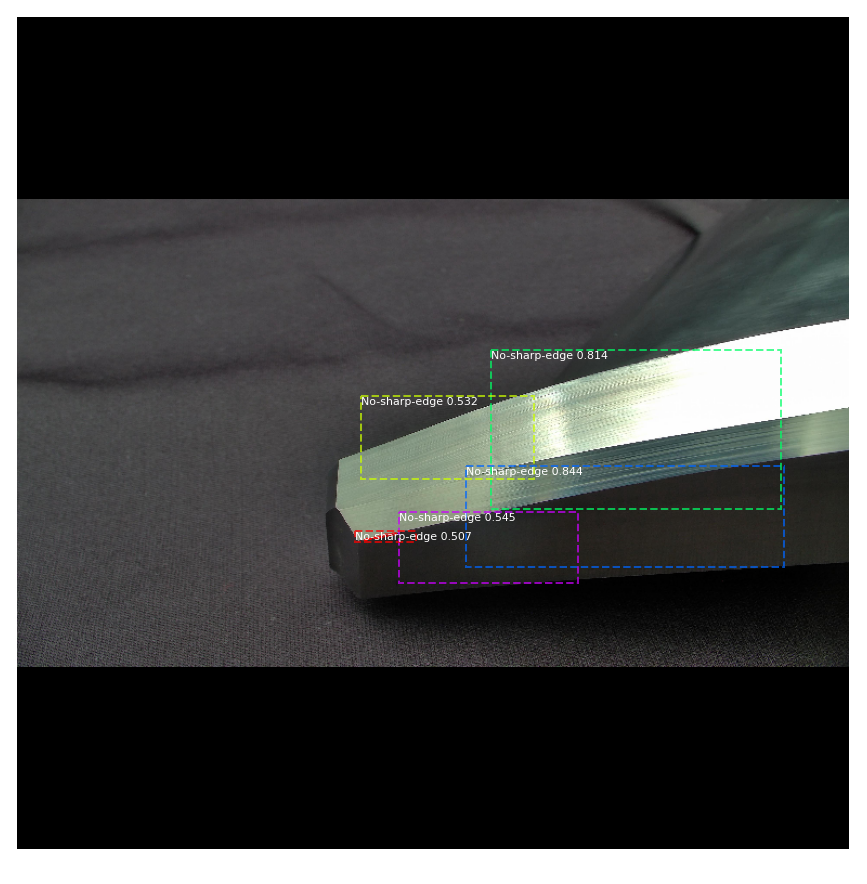

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (1,)                  min:    5.00000  max:    5.00000  int32
gt_bbox                  shape: (1, 4)                min:  408.00000  max:  598.00000  int32
gt_mask                  shape: (768, 768, 1)         min:    0.00000  max:    1.00000  bool


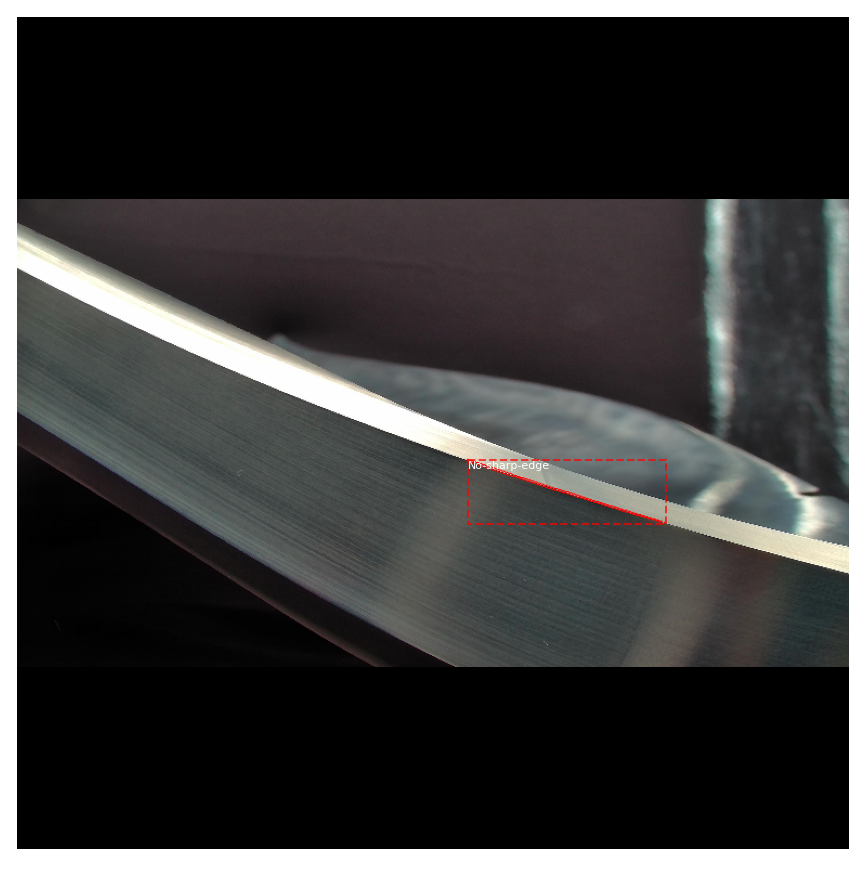

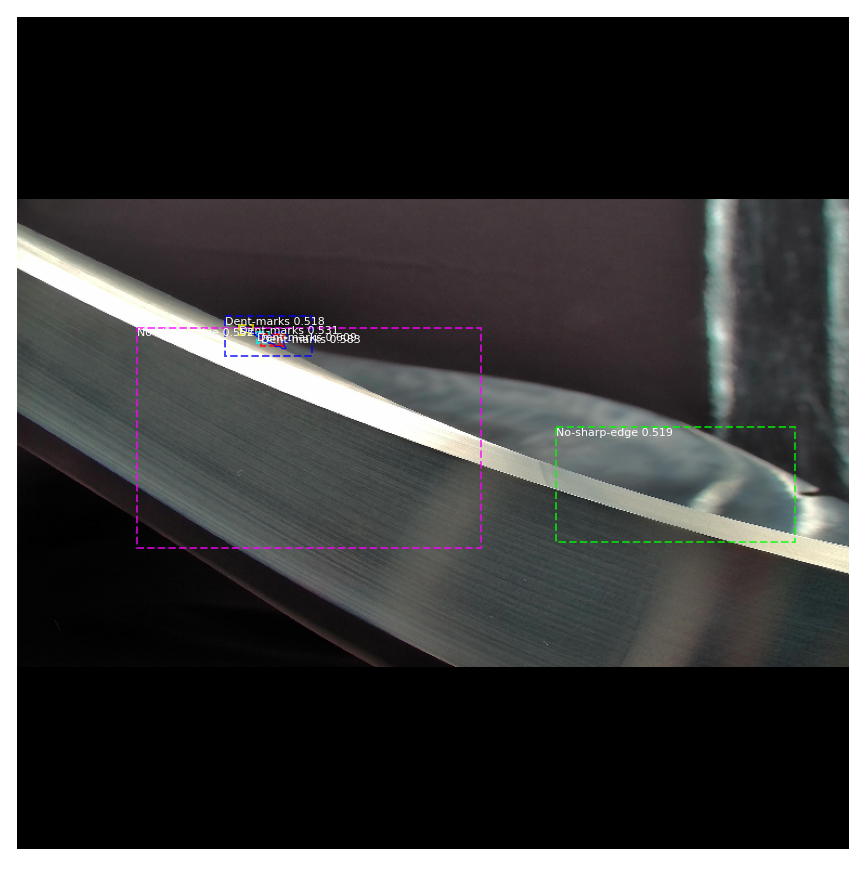

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (5,)                  min:    4.00000  max:    5.00000  int32
gt_bbox                  shape: (5, 4)                min:   50.00000  max:  550.00000  int32
gt_mask                  shape: (768, 768, 5)         min:    0.00000  max:    1.00000  bool


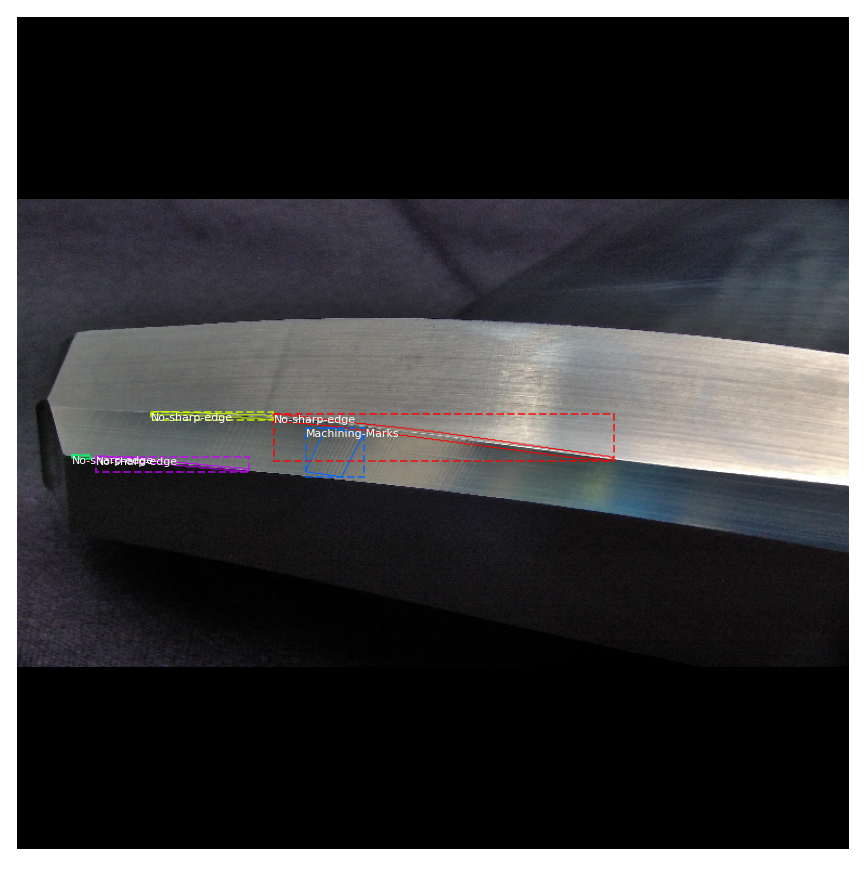


*** No instances to display *** 



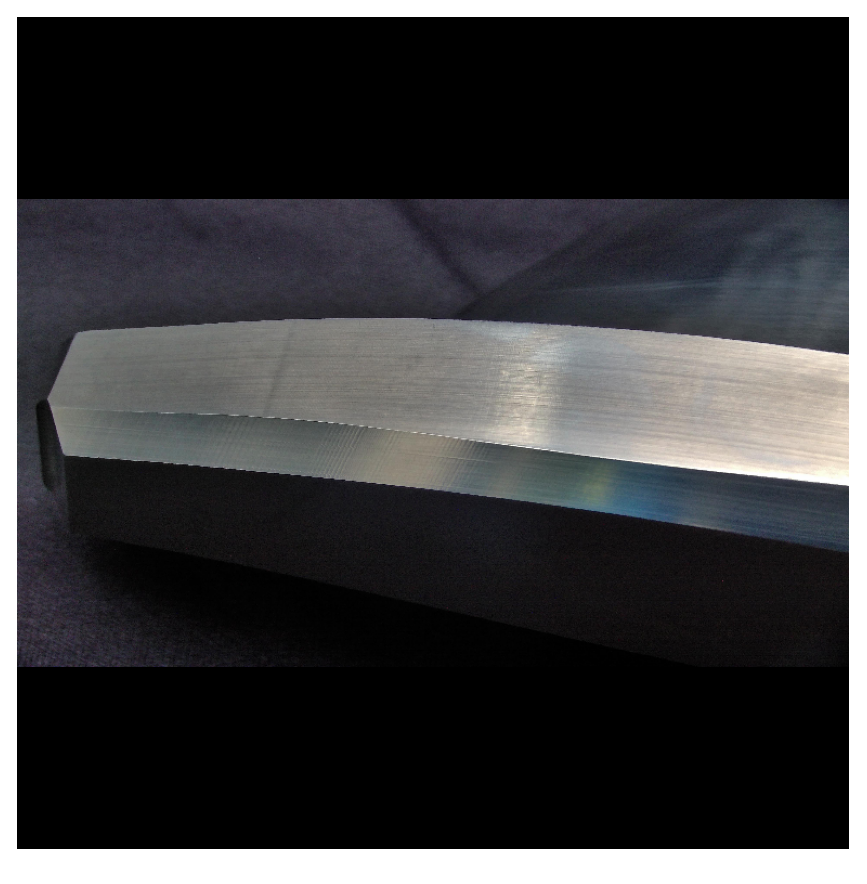

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (0,)                  min:             max:             int32
gt_bbox                  shape: (0, 4)                min:             max:             int32
gt_mask                  shape: (336, 0, 0)           min:             max:             bool

*** No instances to display *** 



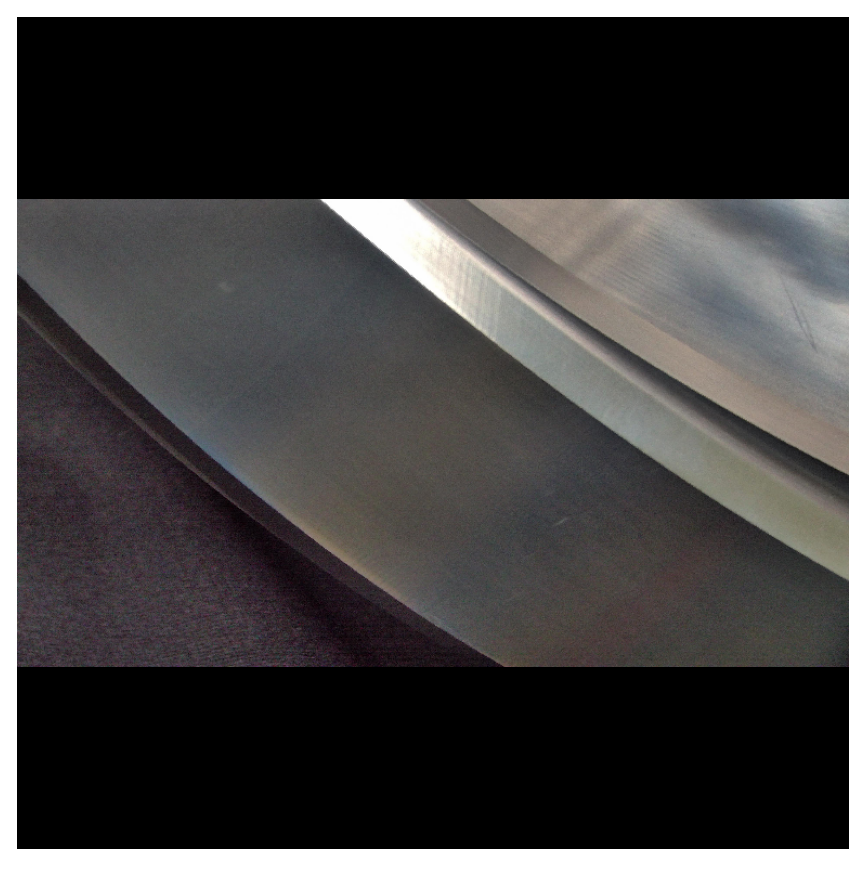

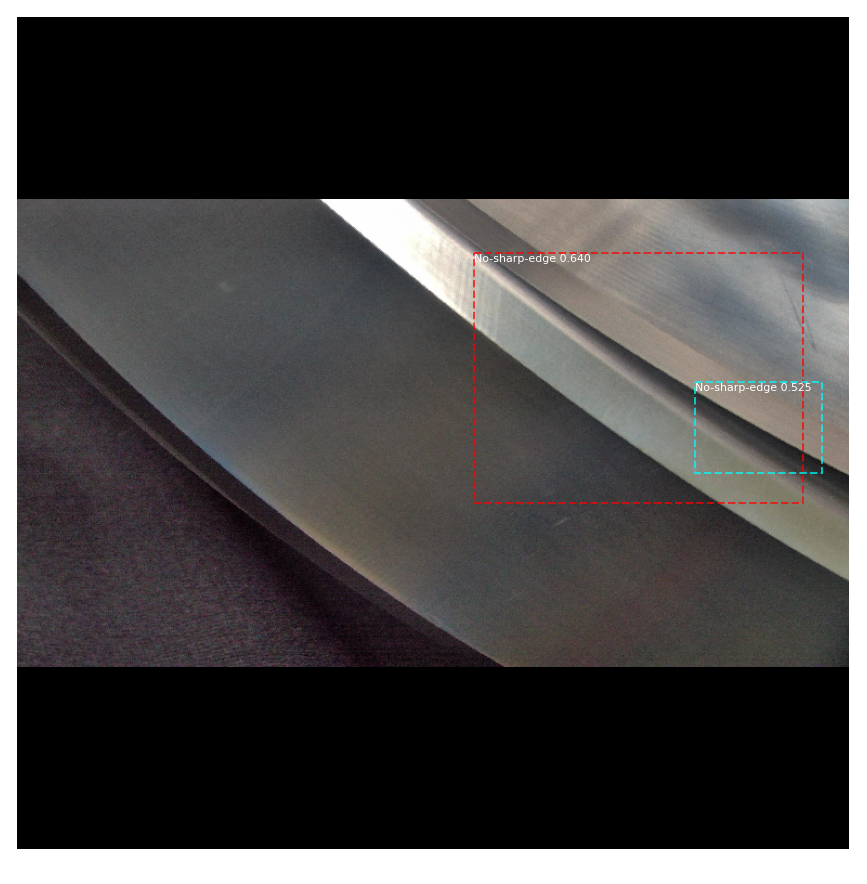

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (1,)                  min:    5.00000  max:    5.00000  int32
gt_bbox                  shape: (1, 4)                min:  361.00000  max:  500.00000  int32
gt_mask                  shape: (768, 768, 1)         min:    0.00000  max:    1.00000  bool


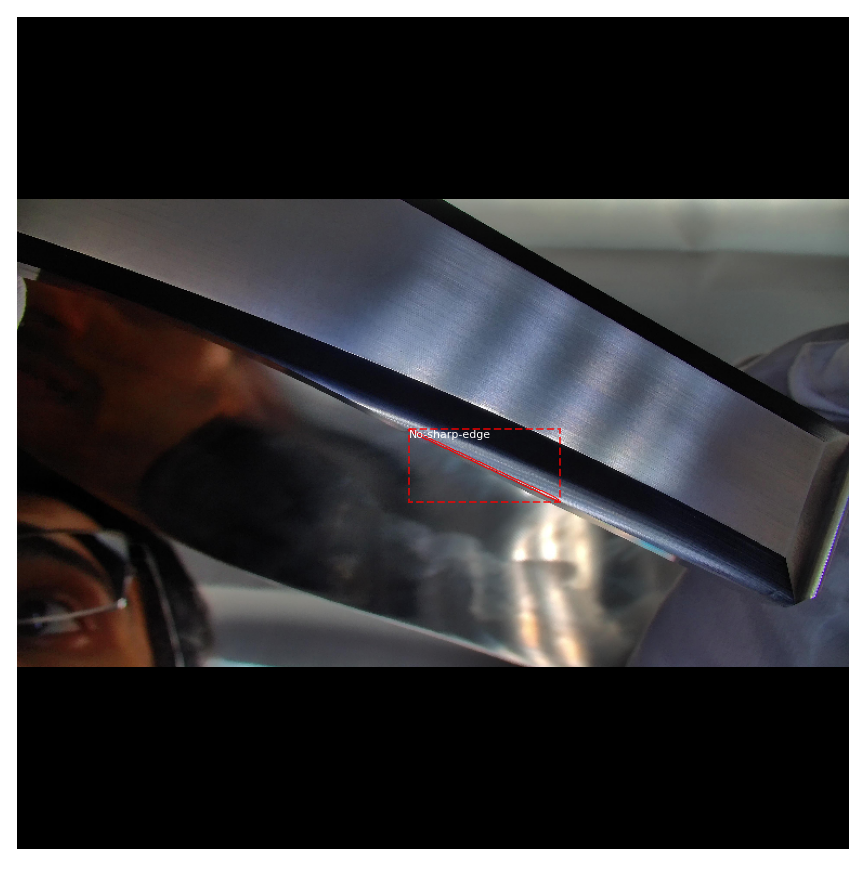

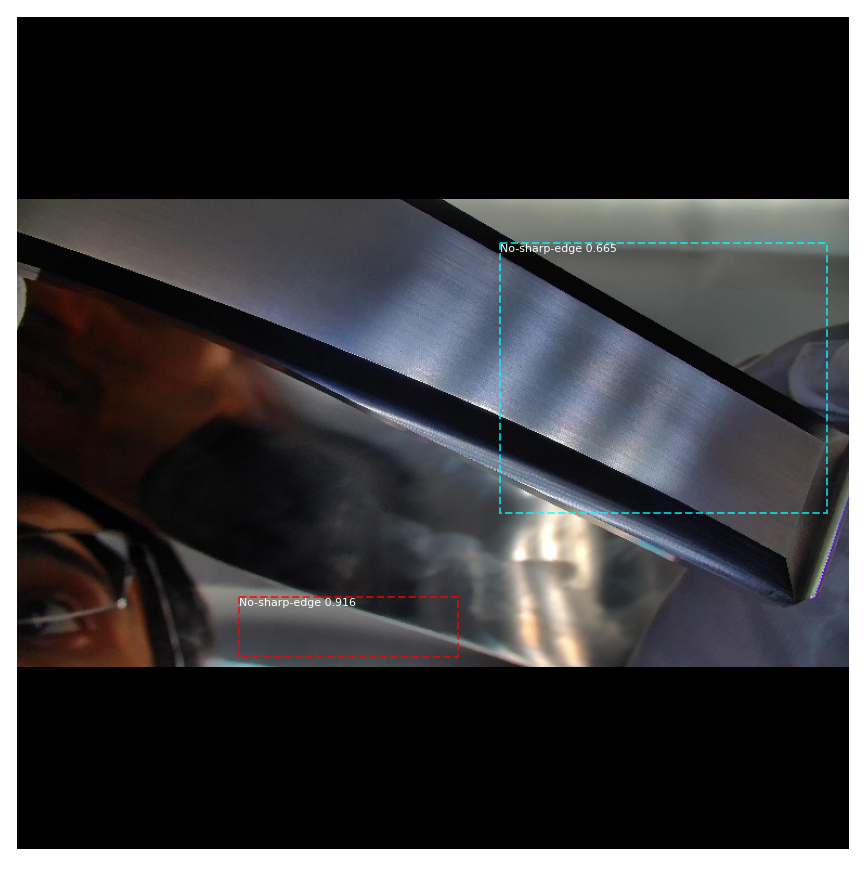

original_image           shape: (768, 768, 3)         min:    0.00000  max:  247.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (7,)                  min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (7, 4)                min:  217.00000  max:  625.00000  int32
gt_mask                  shape: (768, 768, 7)         min:    0.00000  max:    1.00000  bool


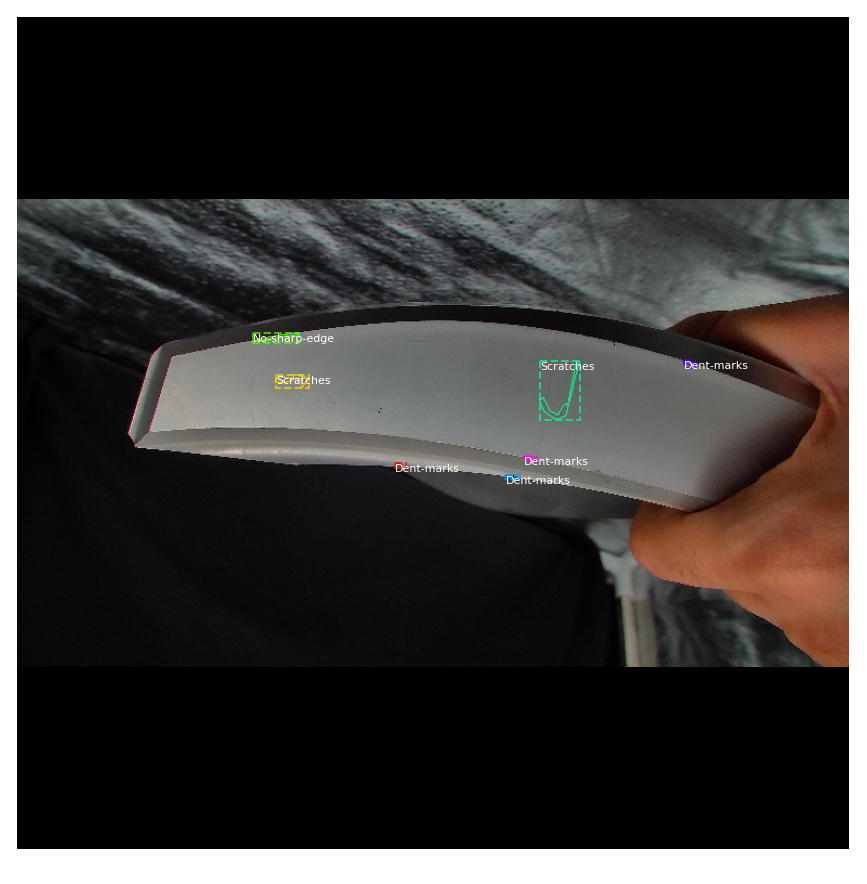


*** No instances to display *** 



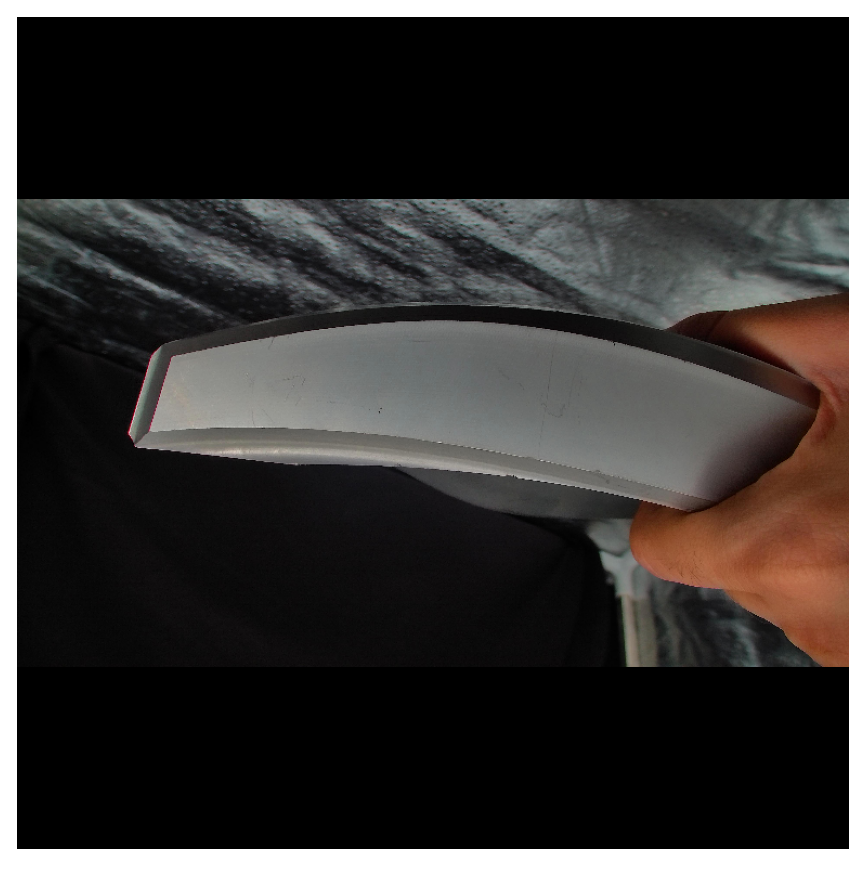

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (17,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (17, 4)               min:    0.00000  max:  696.00000  int32
gt_mask                  shape: (768, 768, 17)        min:    0.00000  max:    1.00000  bool


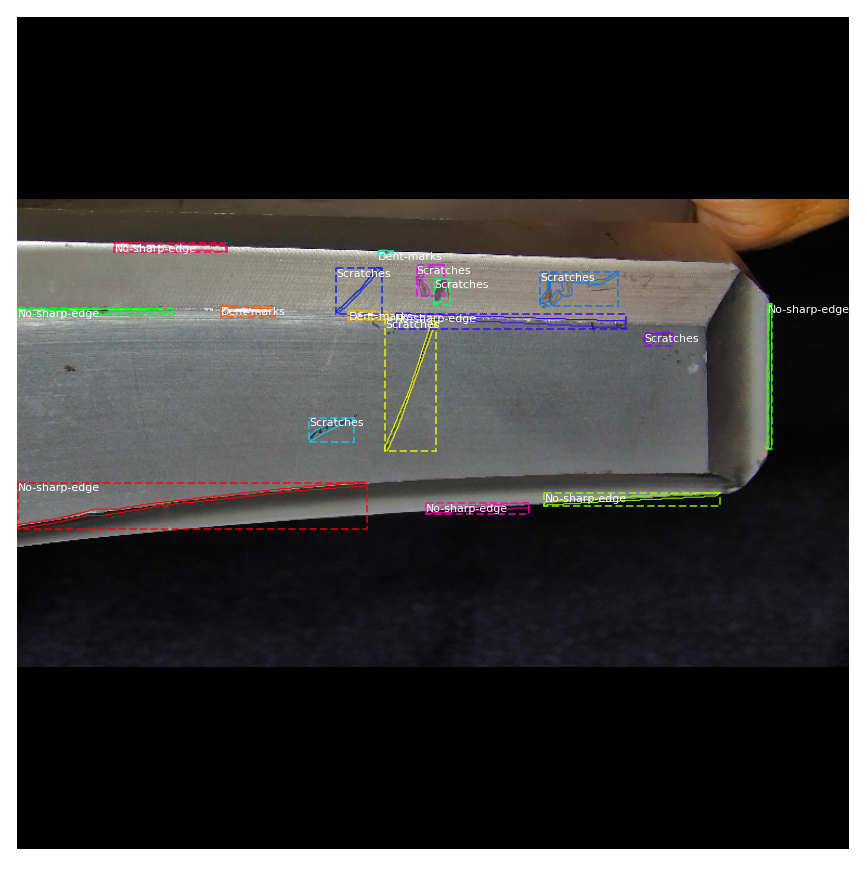

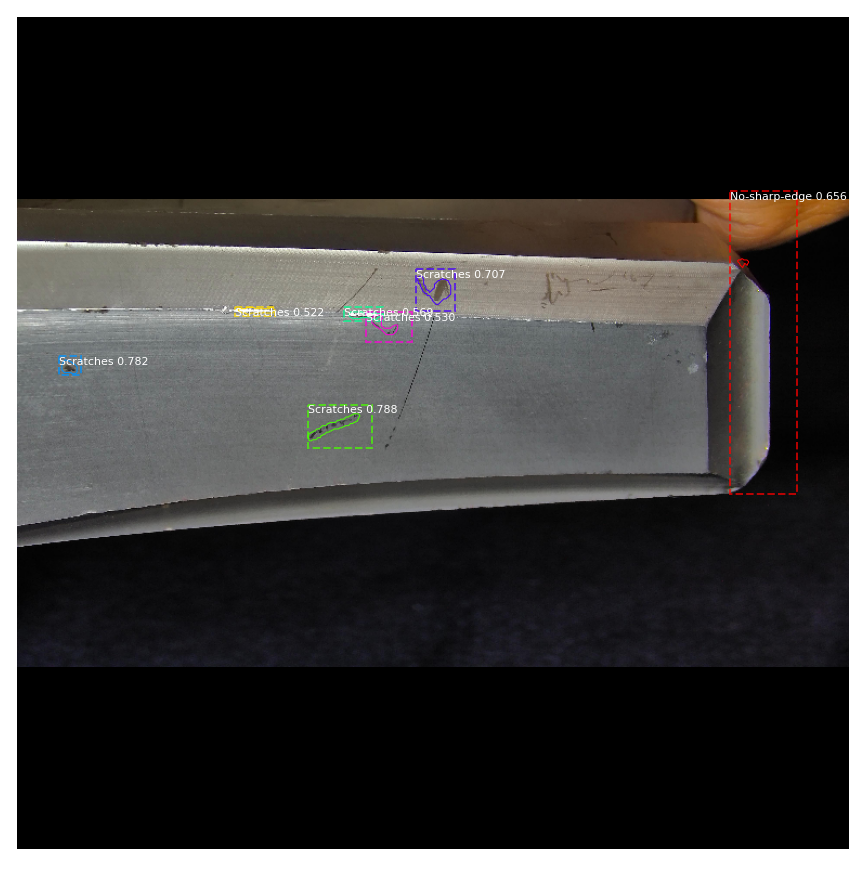

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (15,)                 min:    1.00000  max:    5.00000  int32
gt_bbox                  shape: (15, 4)               min:  131.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 15)        min:    0.00000  max:    1.00000  bool


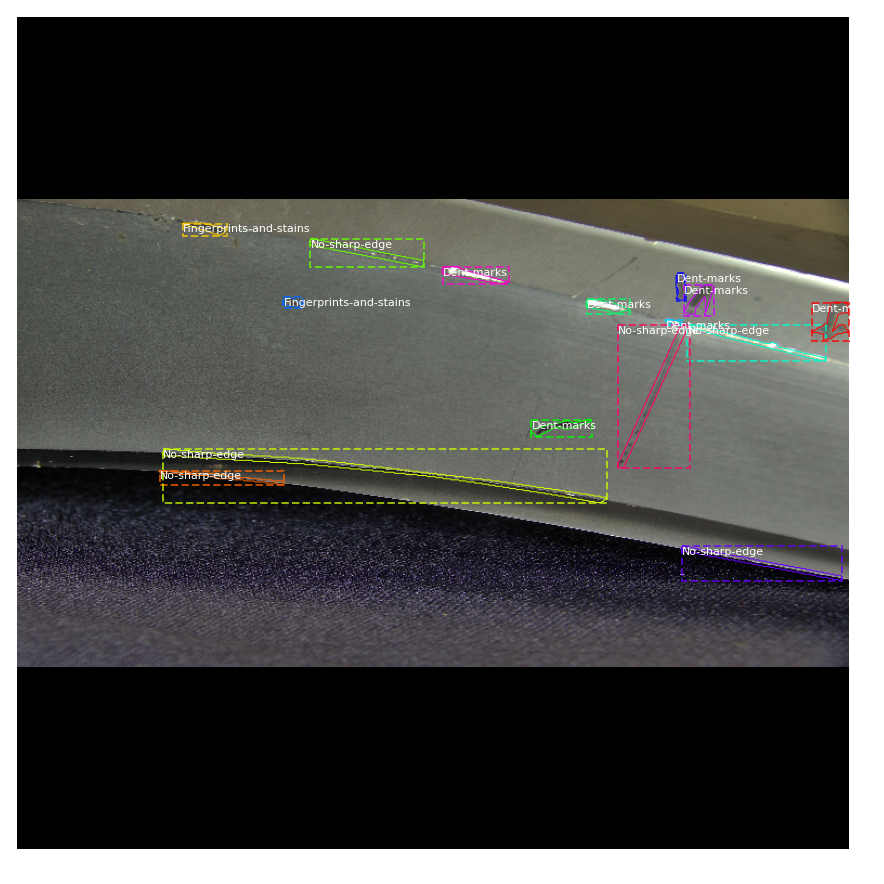

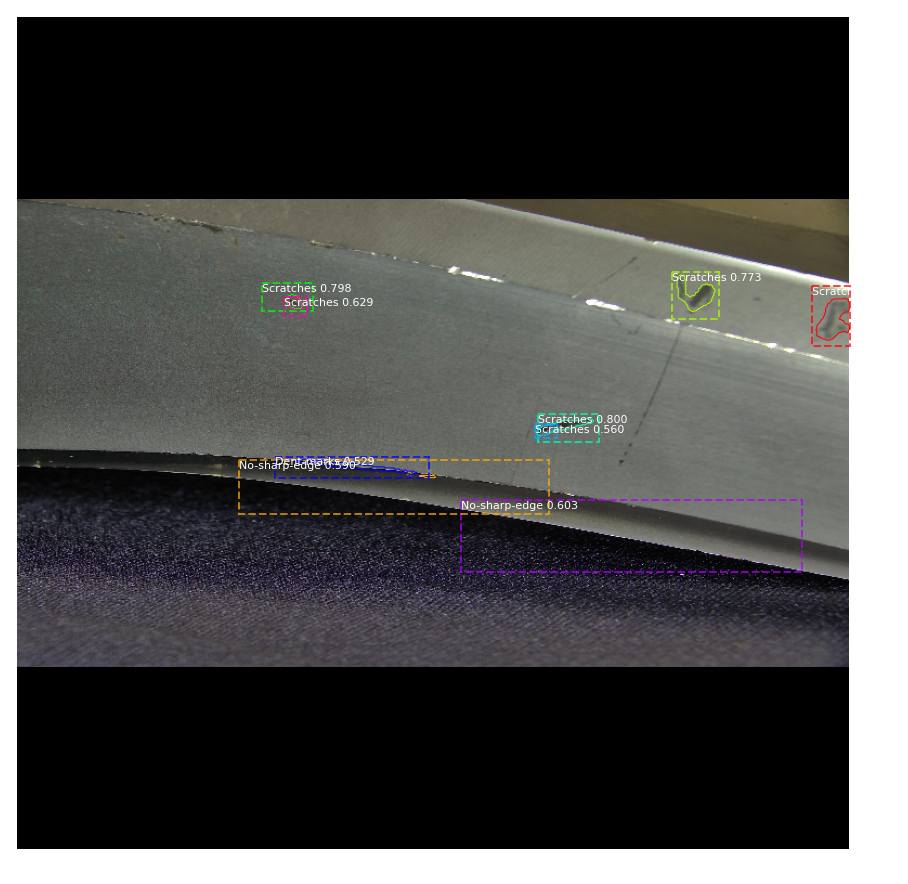

original_image           shape: (768, 768, 3)         min:    0.00000  max:  254.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (1,)                  min:    3.00000  max:    3.00000  int32
gt_bbox                  shape: (1, 4)                min:  278.00000  max:  594.00000  int32
gt_mask                  shape: (768, 768, 1)         min:    0.00000  max:    1.00000  bool


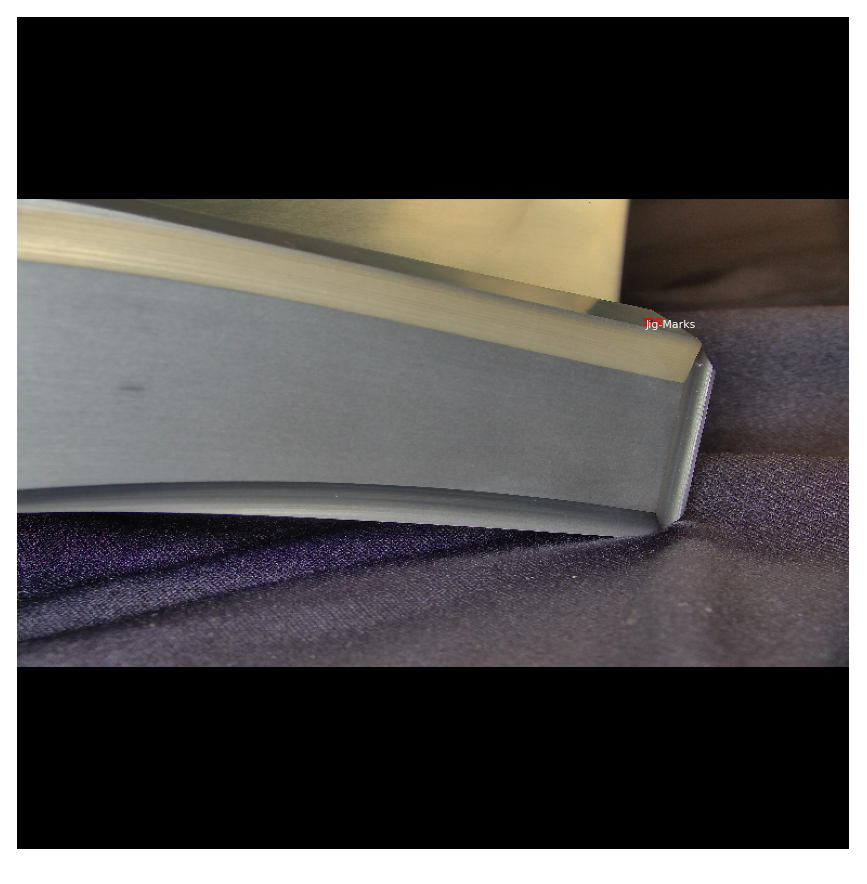

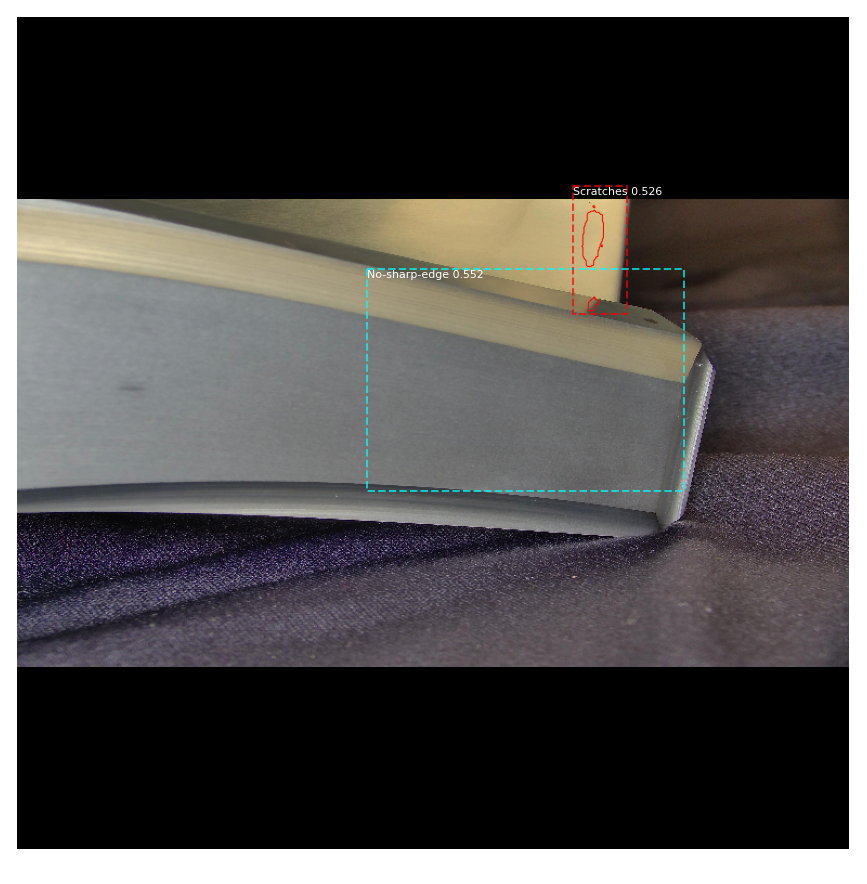

original_image           shape: (768, 768, 3)         min:    0.00000  max:  254.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (2,)                  min:    2.00000  max:    6.00000  int32
gt_bbox                  shape: (2, 4)                min:    1.00000  max:  611.00000  int32
gt_mask                  shape: (768, 768, 2)         min:    0.00000  max:    1.00000  bool


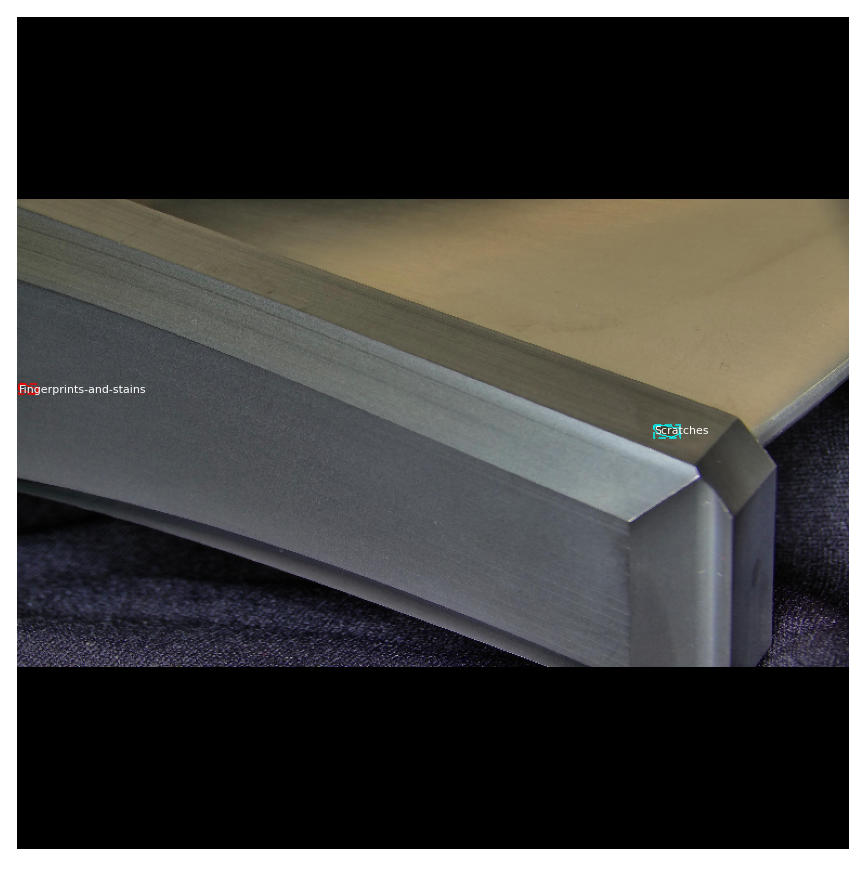

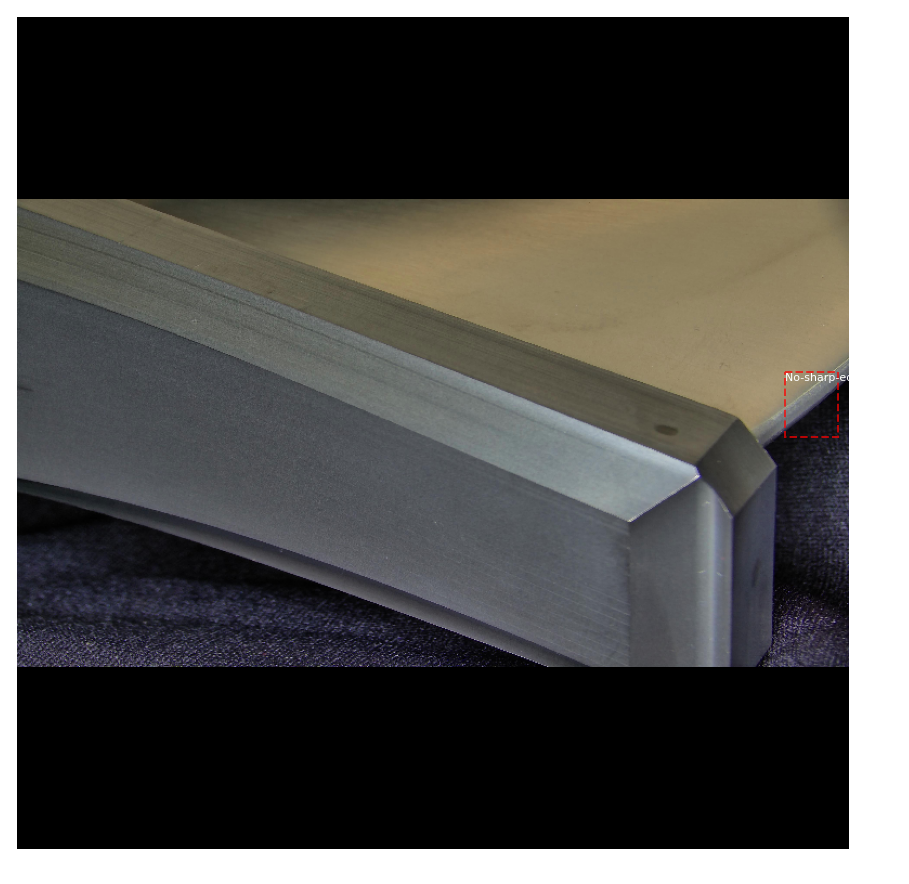

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (18,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (18, 4)               min:    4.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 18)        min:    0.00000  max:    1.00000  bool


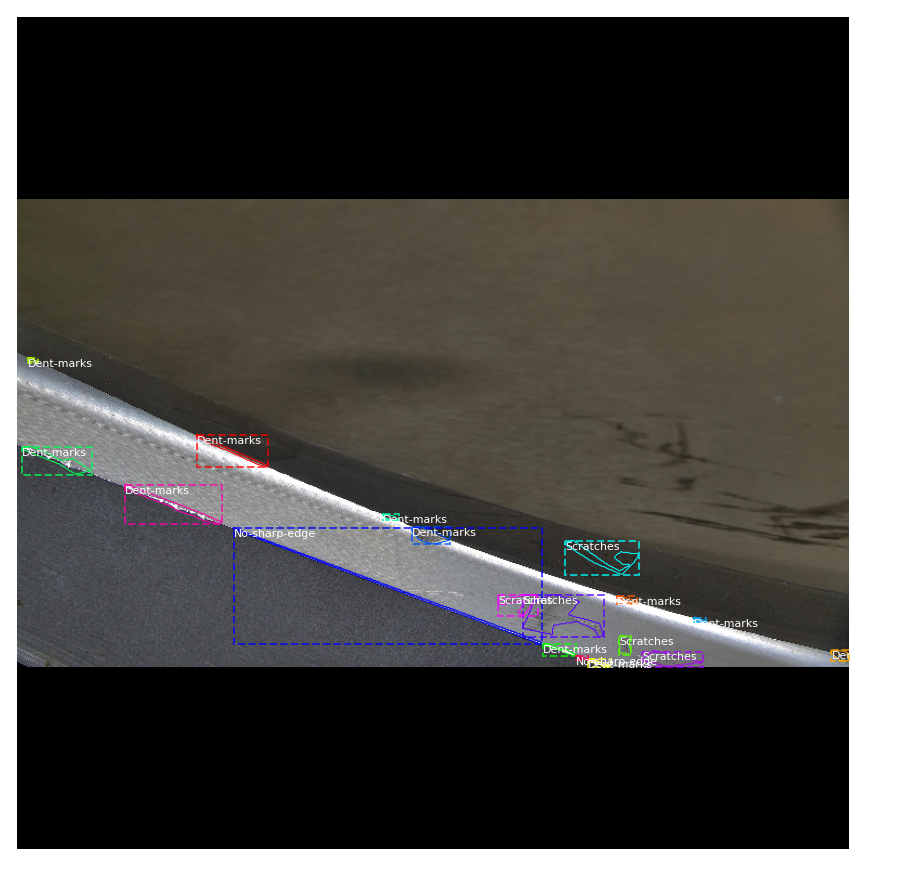

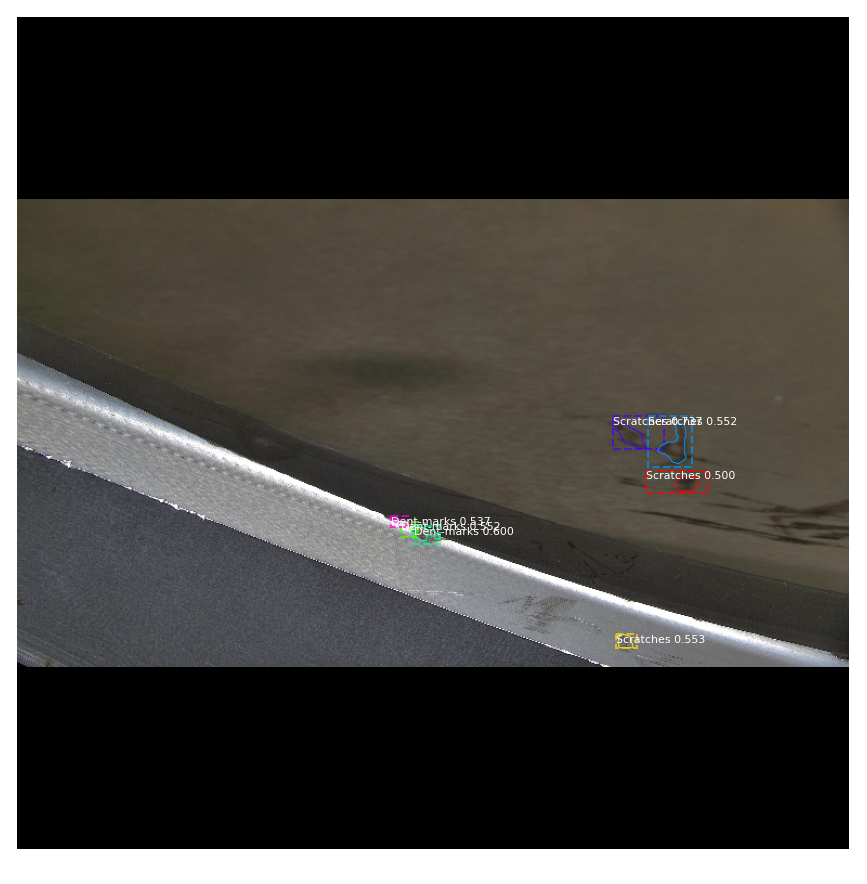

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (6,)                  min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (6, 4)                min:  135.00000  max:  601.00000  int32
gt_mask                  shape: (768, 768, 6)         min:    0.00000  max:    1.00000  bool


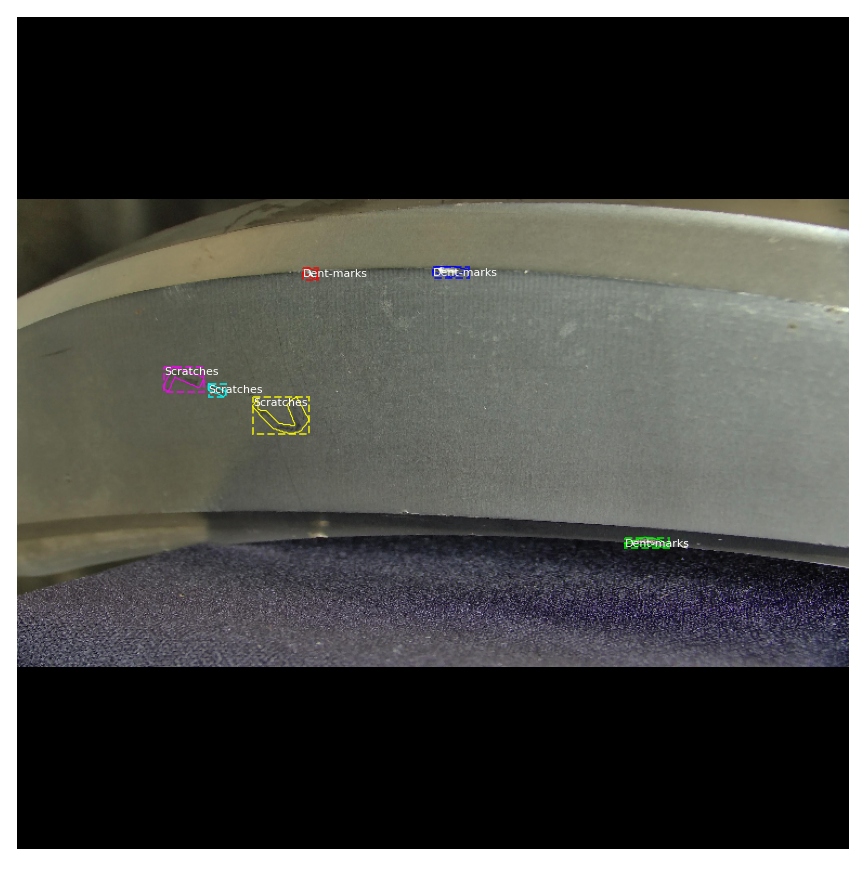

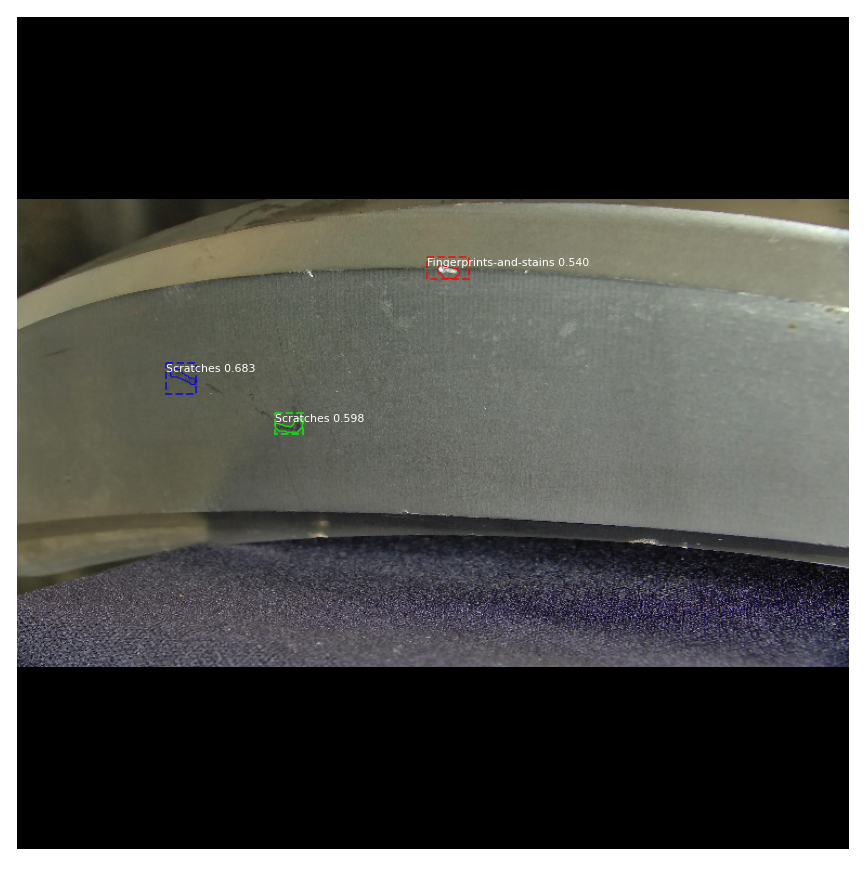

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (4,)                  min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (4, 4)                min:  140.00000  max:  484.00000  int32
gt_mask                  shape: (768, 768, 4)         min:    0.00000  max:    1.00000  bool


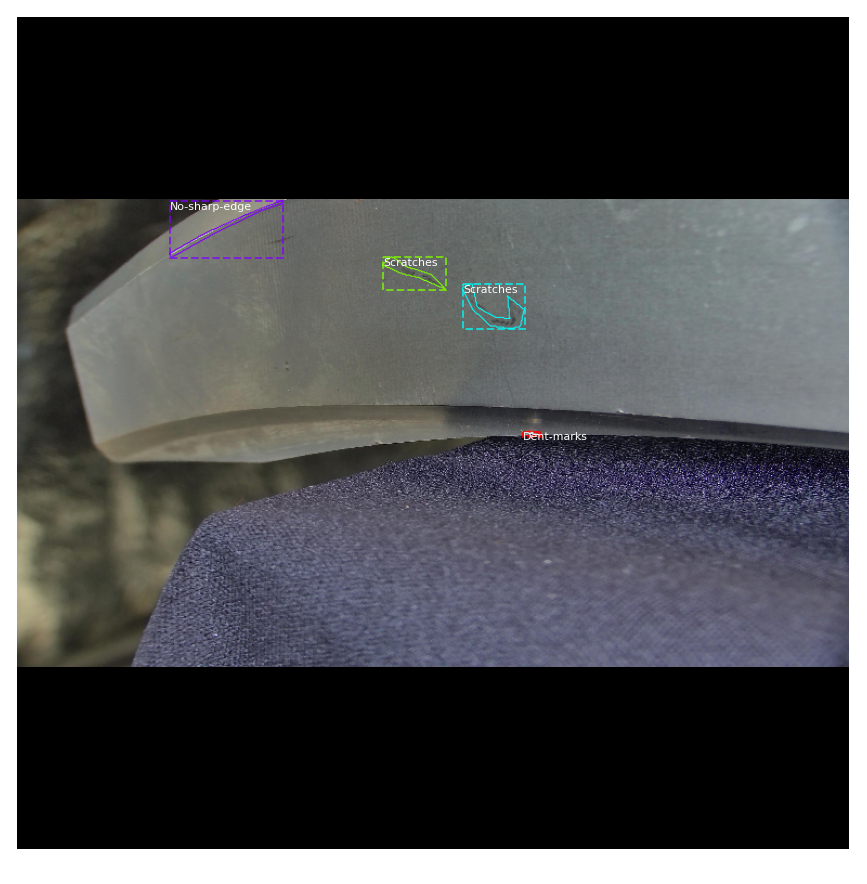

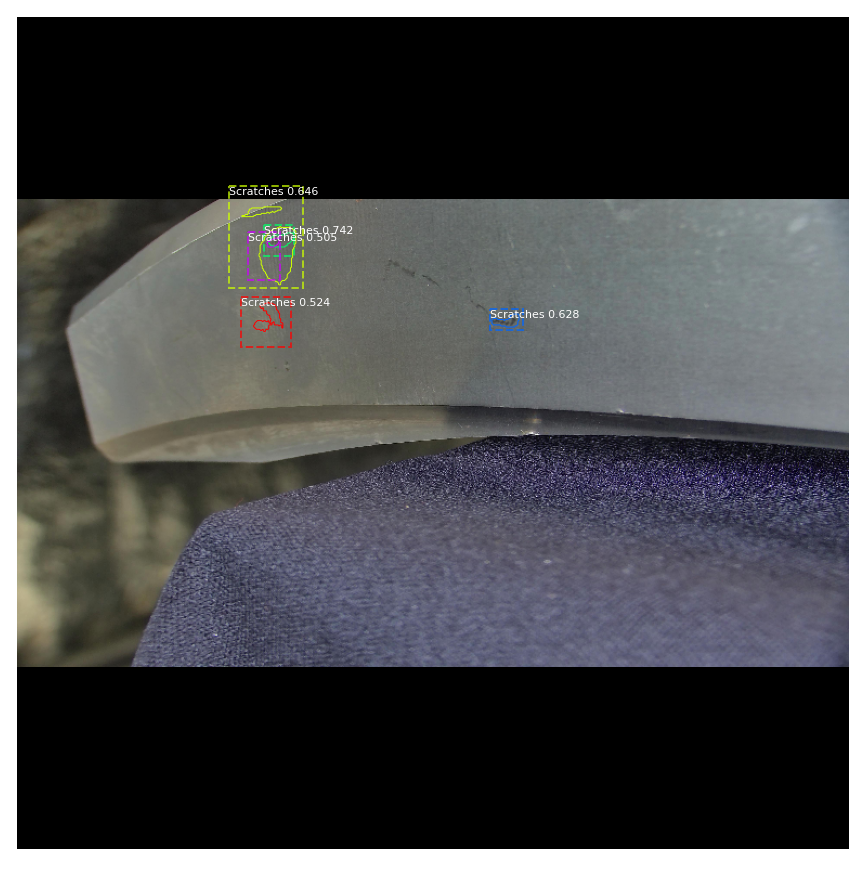

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (36,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (36, 4)               min:  143.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 36)        min:    0.00000  max:    1.00000  bool


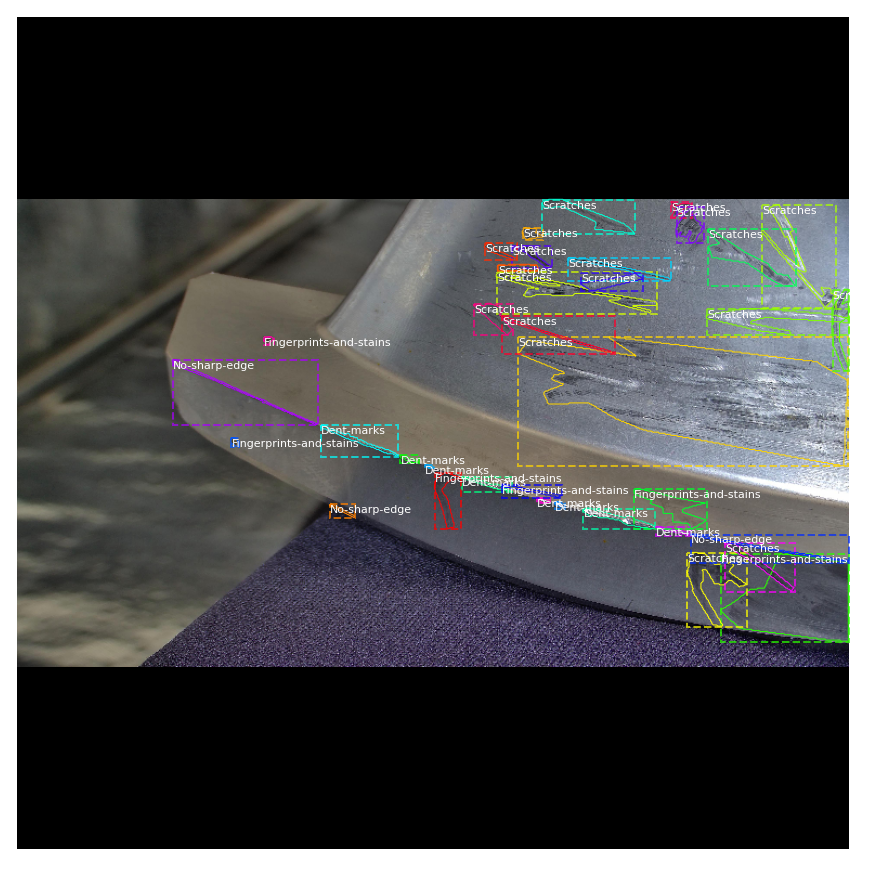

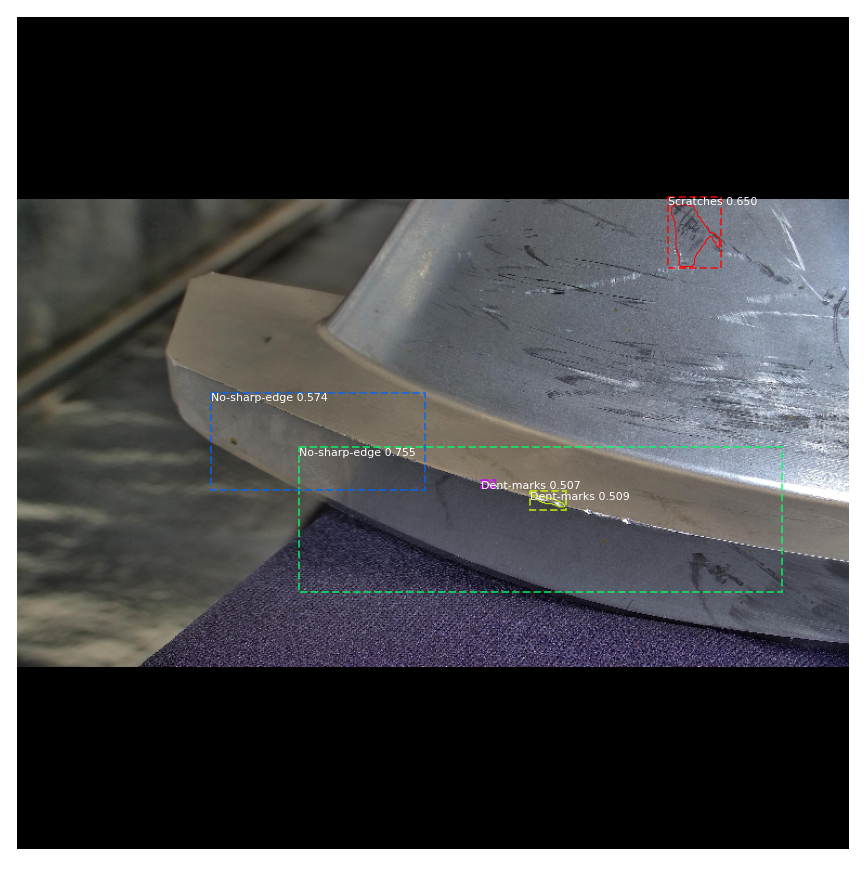

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (21,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (21, 4)               min:    0.00000  max:  713.00000  int32
gt_mask                  shape: (768, 768, 21)        min:    0.00000  max:    1.00000  bool


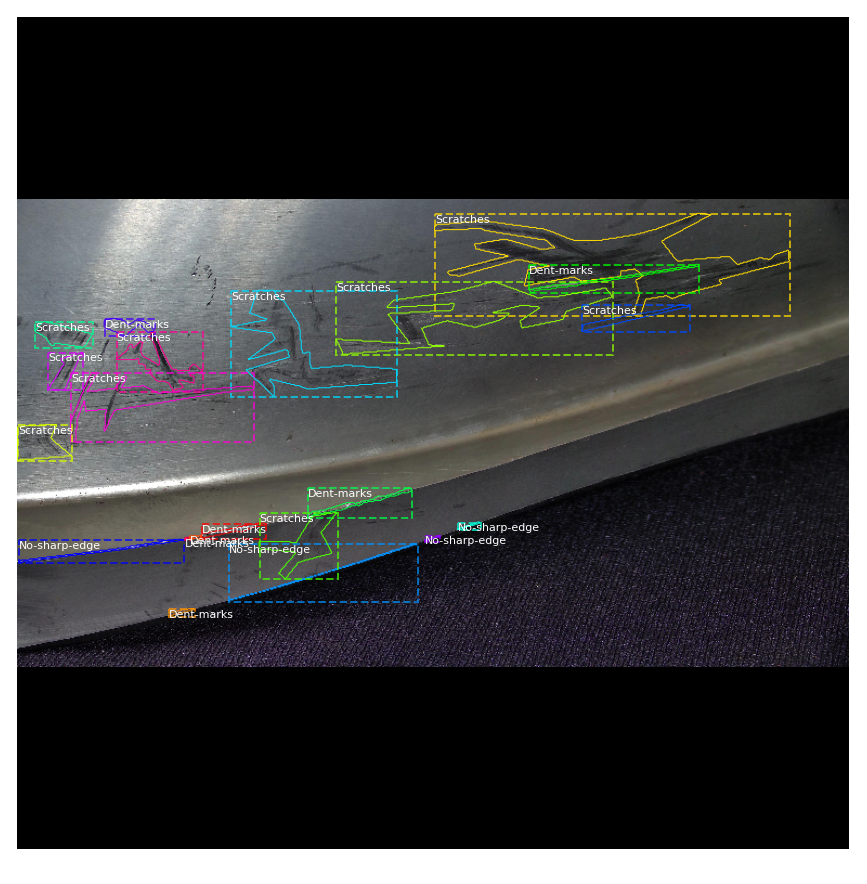

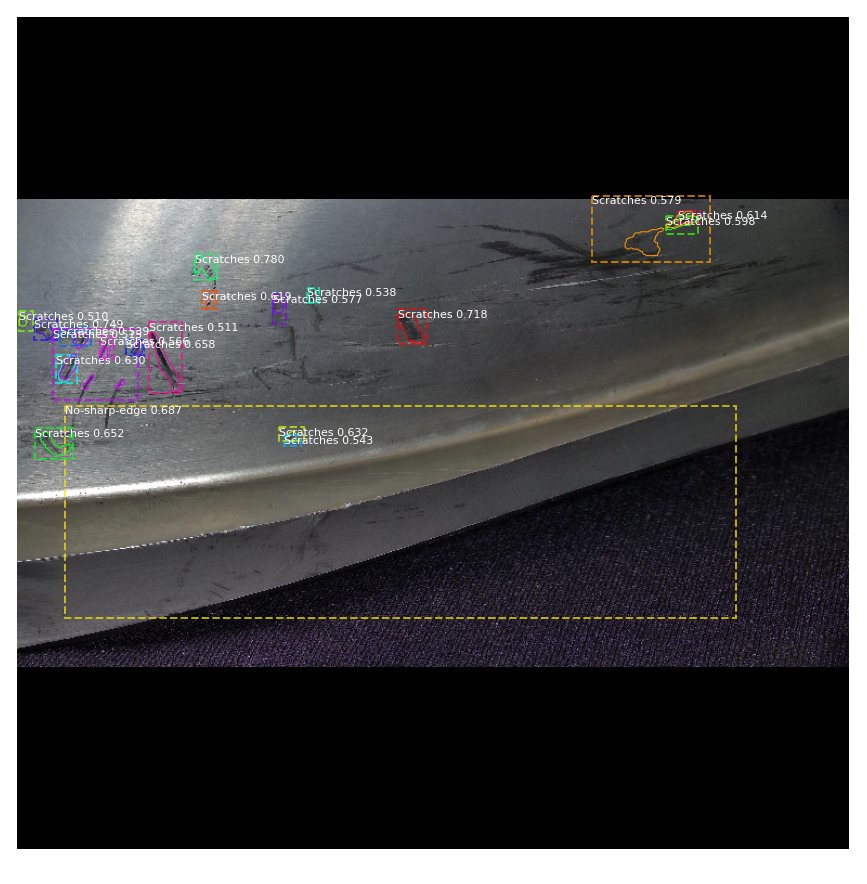

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (6,)                  min:    3.00000  max:    6.00000  int32
gt_bbox                  shape: (6, 4)                min:    0.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 6)         min:    0.00000  max:    1.00000  bool


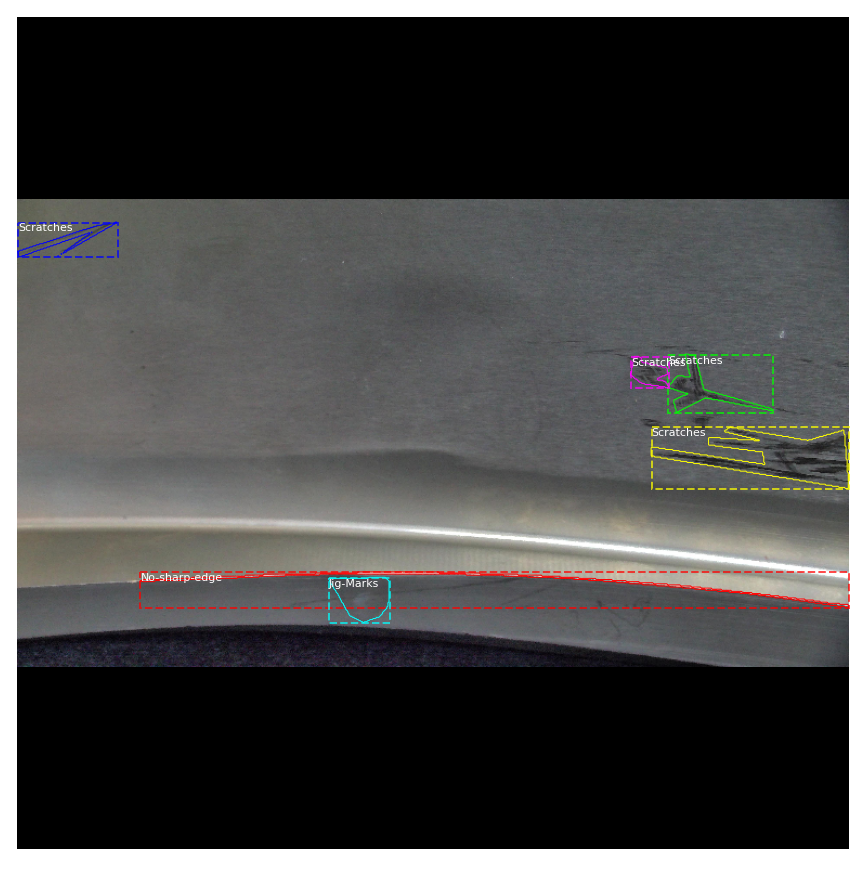

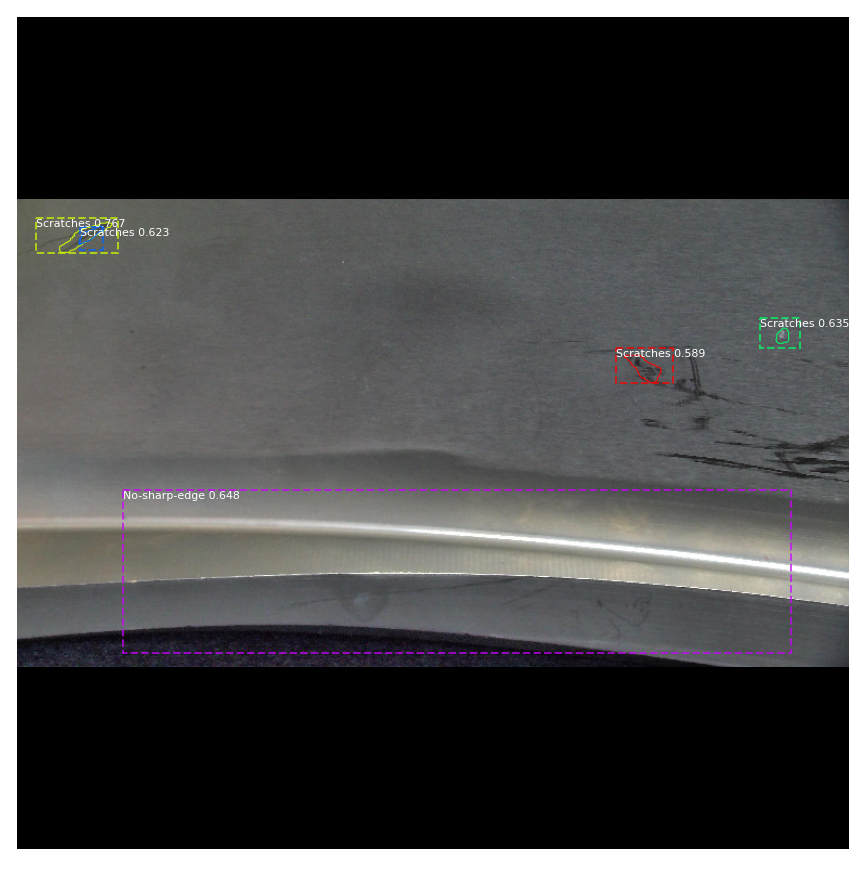

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (15,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (15, 4)               min:    0.00000  max:  737.00000  int32
gt_mask                  shape: (768, 768, 15)        min:    0.00000  max:    1.00000  bool


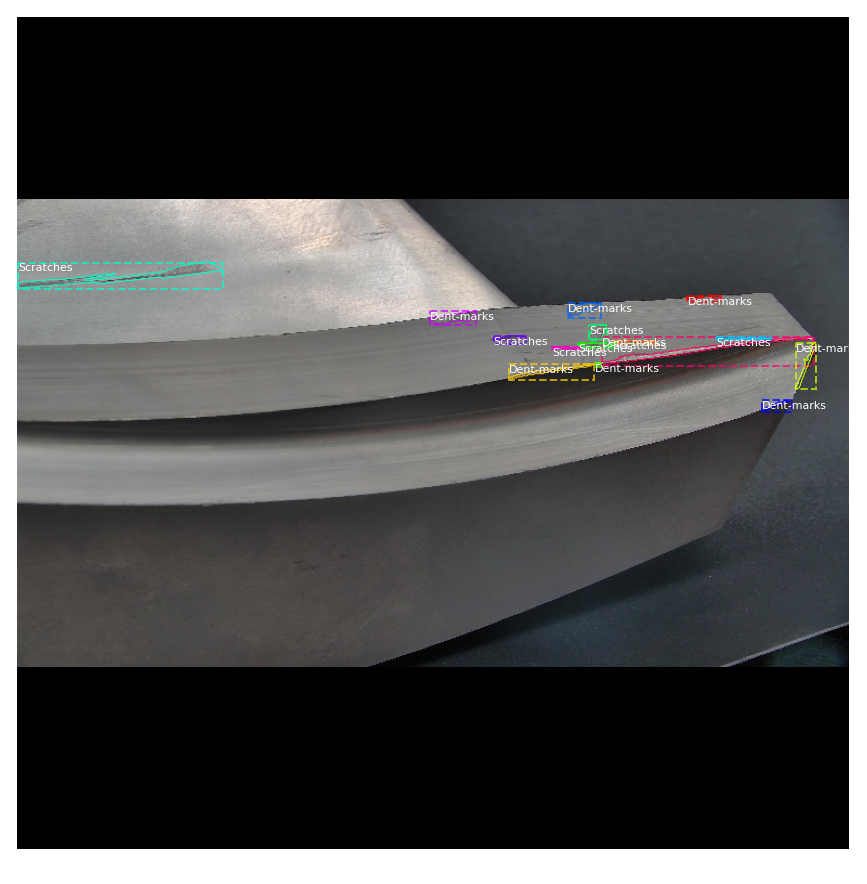

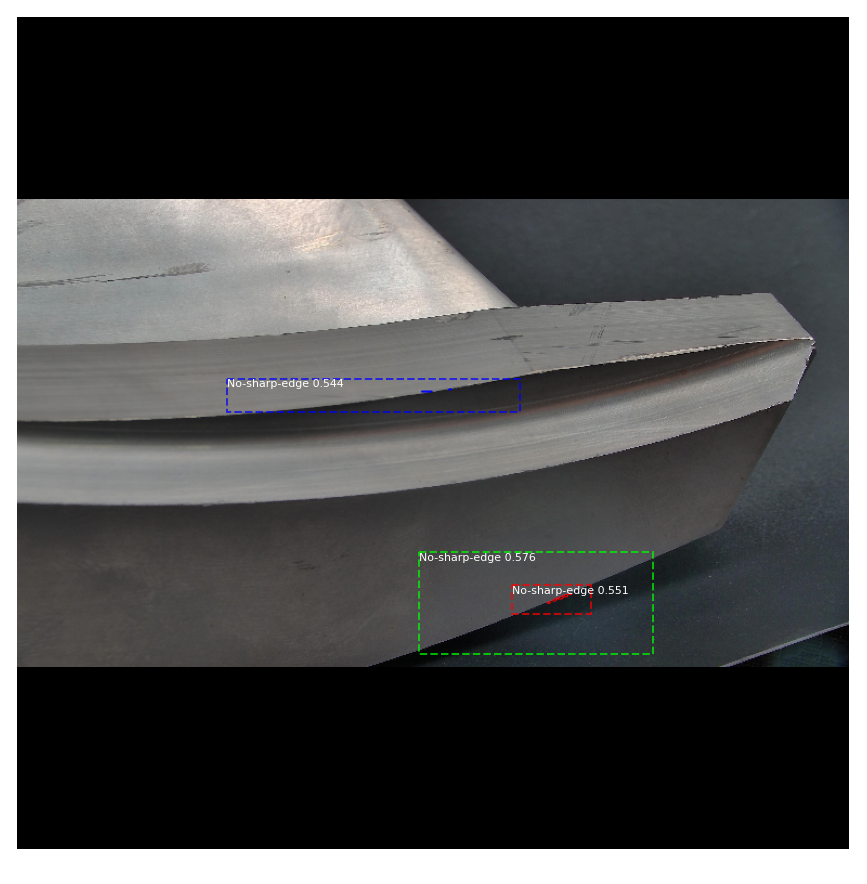

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (5,)                  min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (5, 4)                min:    3.00000  max:  519.00000  int32
gt_mask                  shape: (768, 768, 5)         min:    0.00000  max:    1.00000  bool


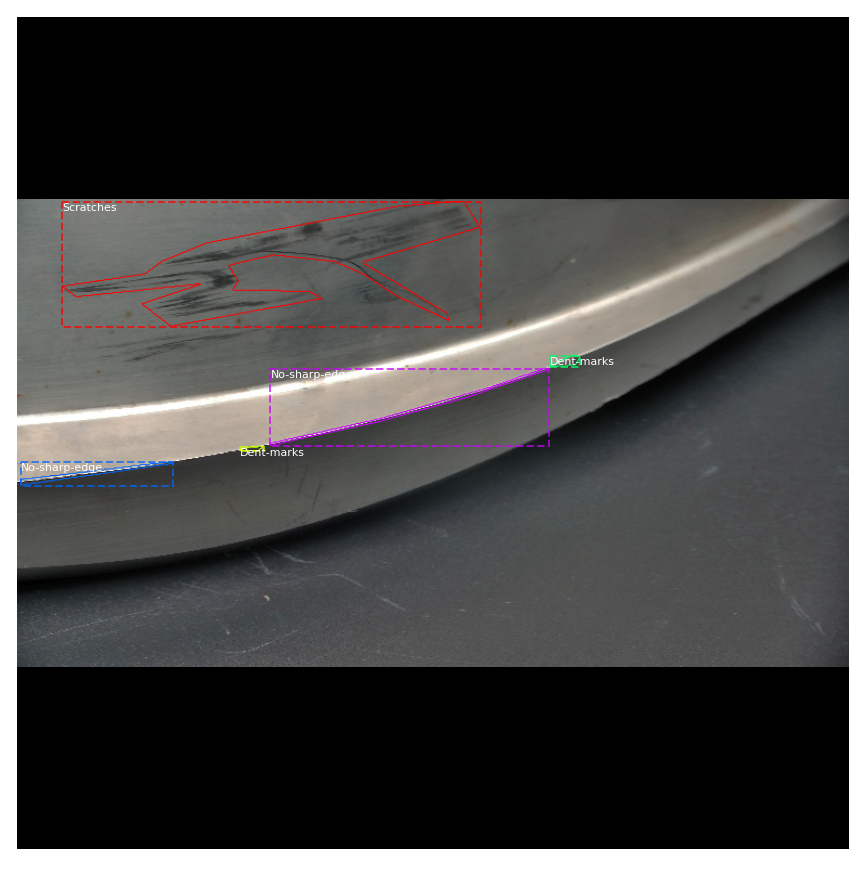

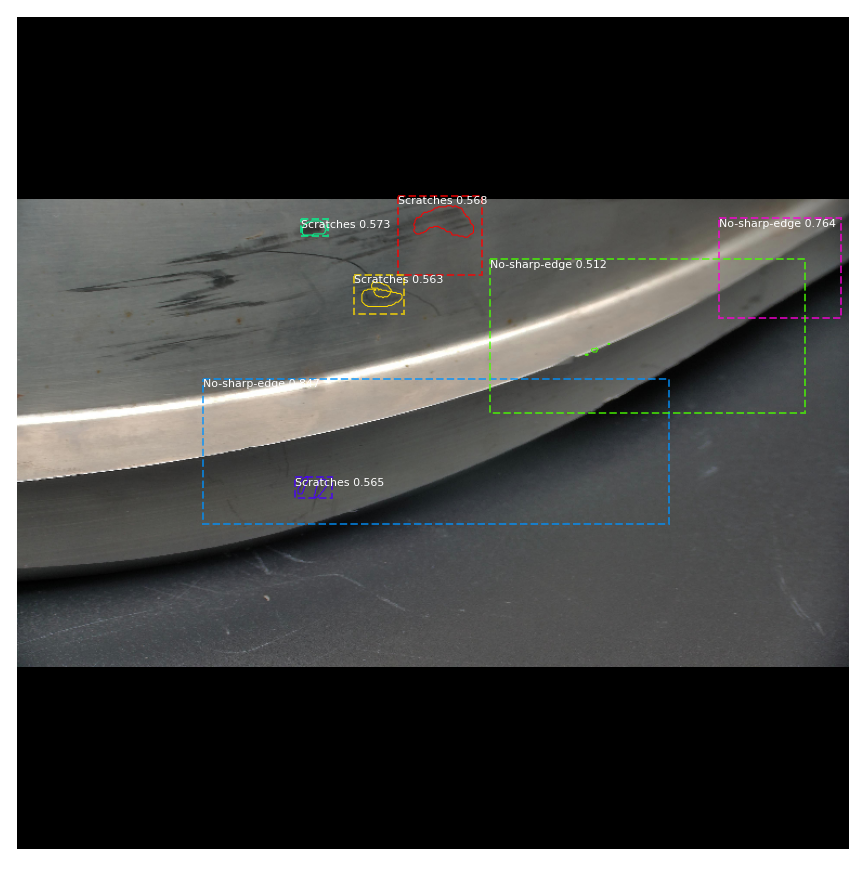

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (12,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (12, 4)               min:    1.00000  max:  540.00000  int32
gt_mask                  shape: (768, 768, 12)        min:    0.00000  max:    1.00000  bool


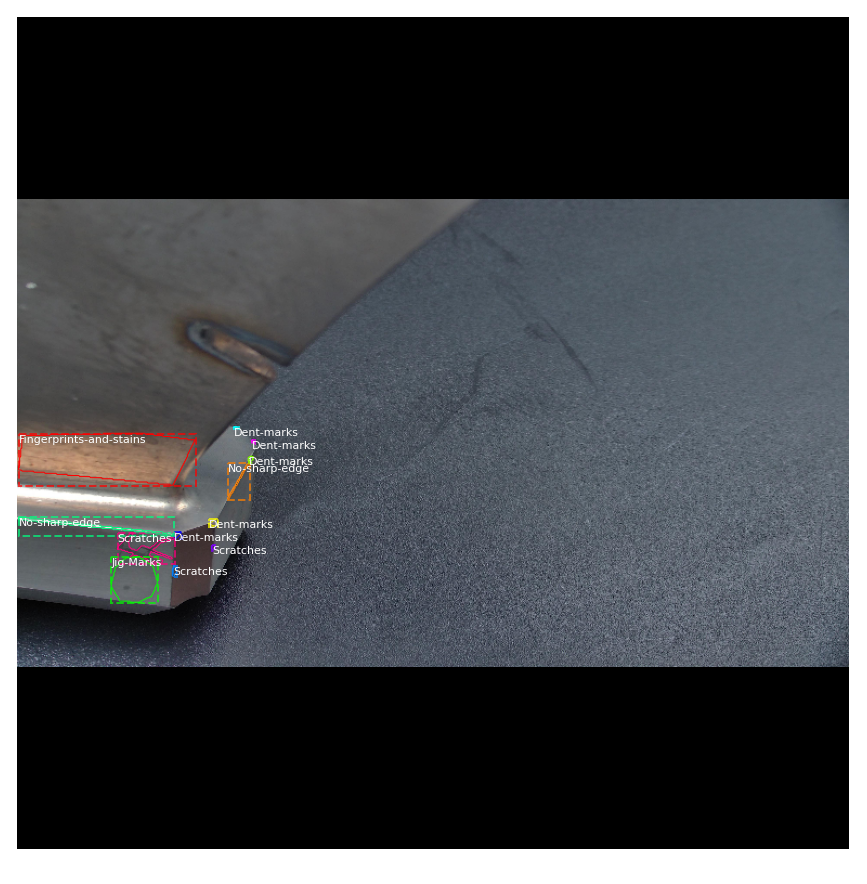

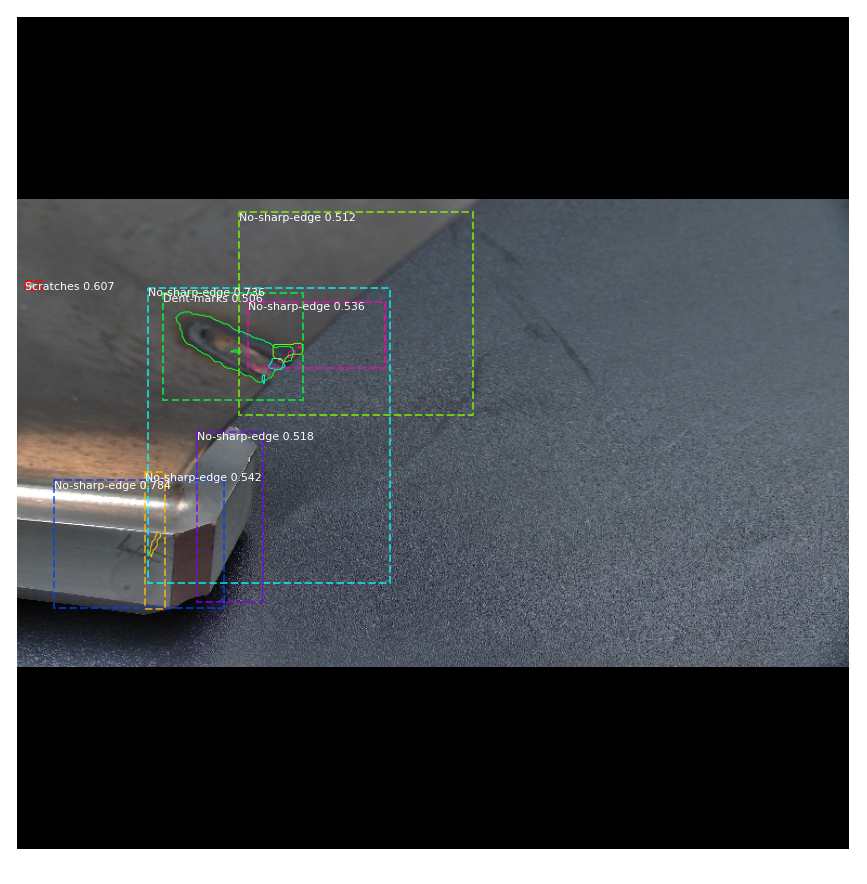

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (8,)                  min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (8, 4)                min:  306.00000  max:  759.00000  int32
gt_mask                  shape: (768, 768, 8)         min:    0.00000  max:    1.00000  bool


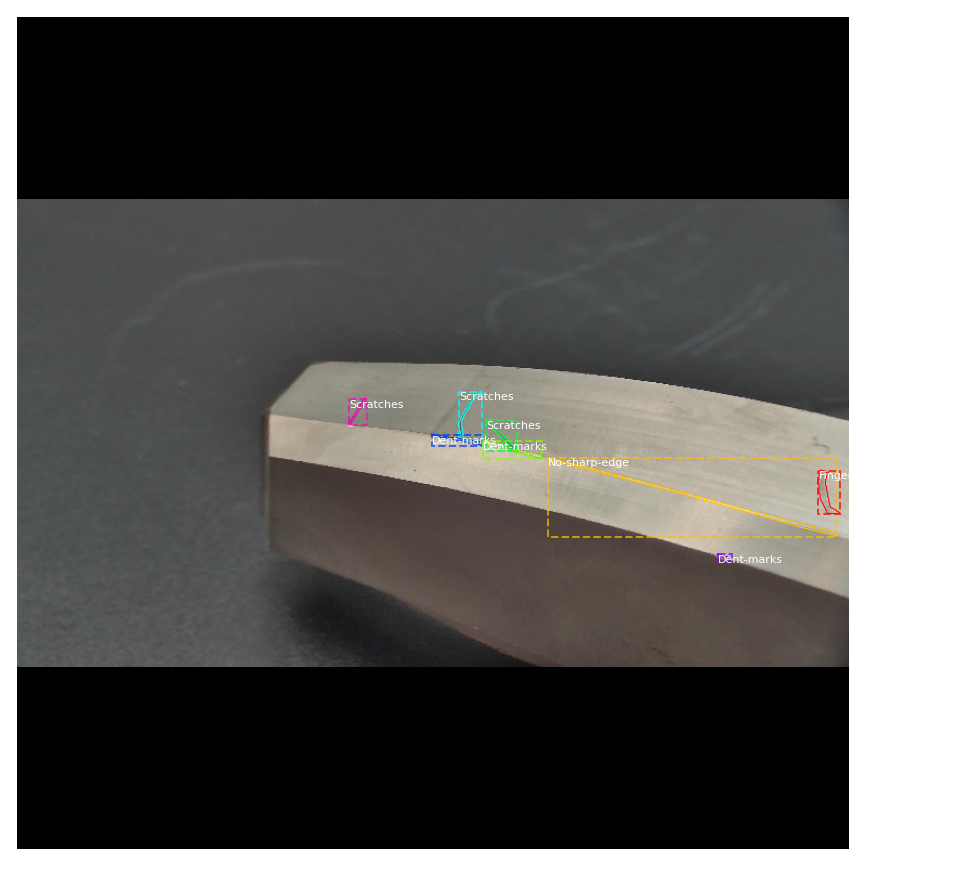

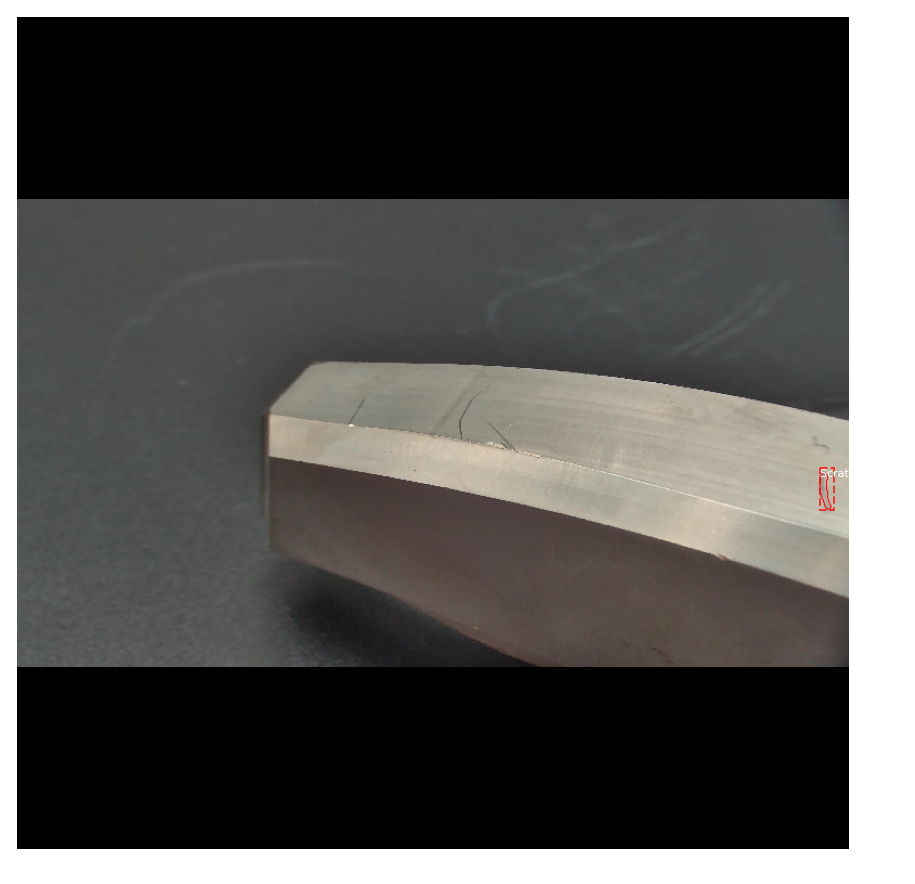

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (11,)                 min:    1.00000  max:    5.00000  int32
gt_bbox                  shape: (11, 4)               min:  180.00000  max:  623.00000  int32
gt_mask                  shape: (768, 768, 11)        min:    0.00000  max:    1.00000  bool


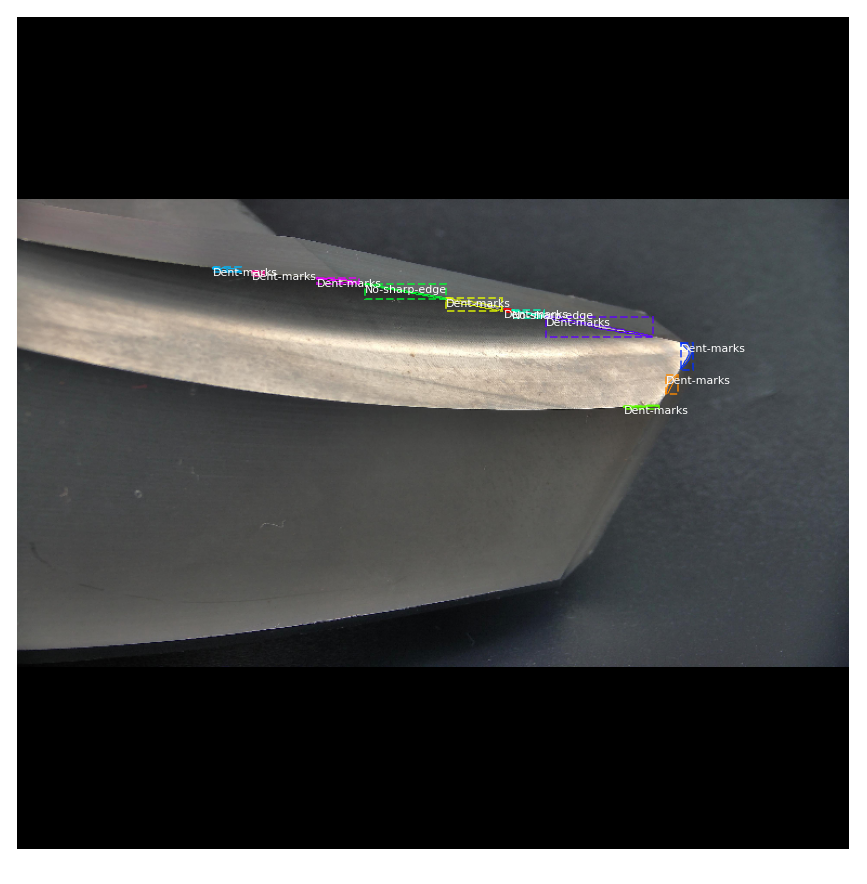

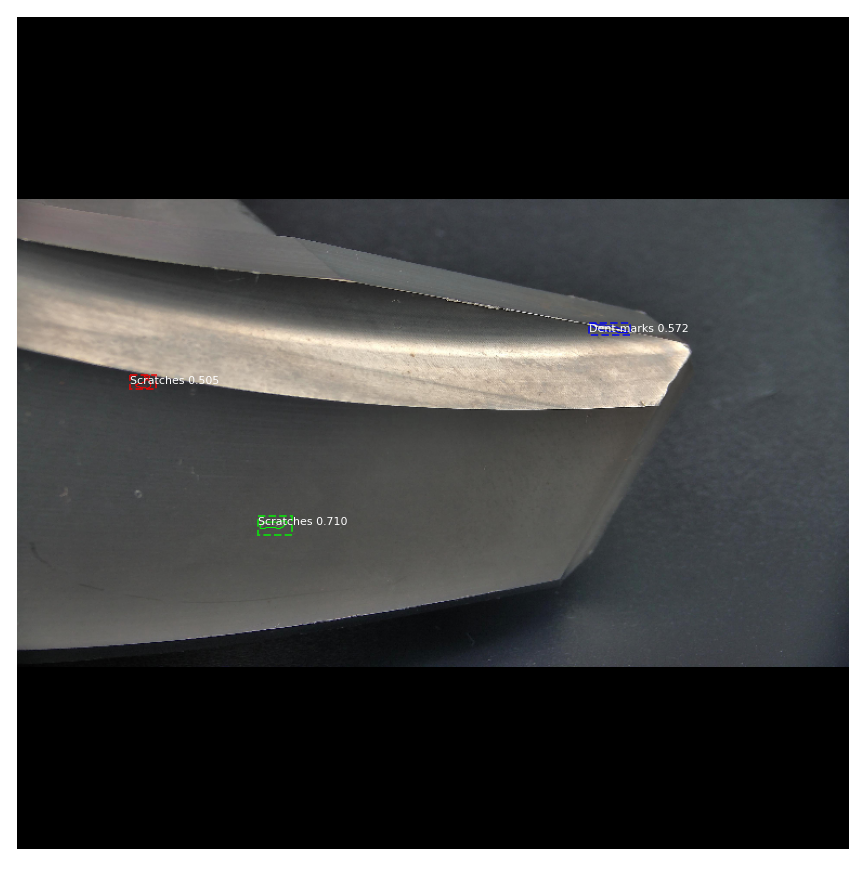

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (4,)                  min:    1.00000  max:    5.00000  int32
gt_bbox                  shape: (4, 4)                min:  169.00000  max:  742.00000  int32
gt_mask                  shape: (768, 768, 4)         min:    0.00000  max:    1.00000  bool


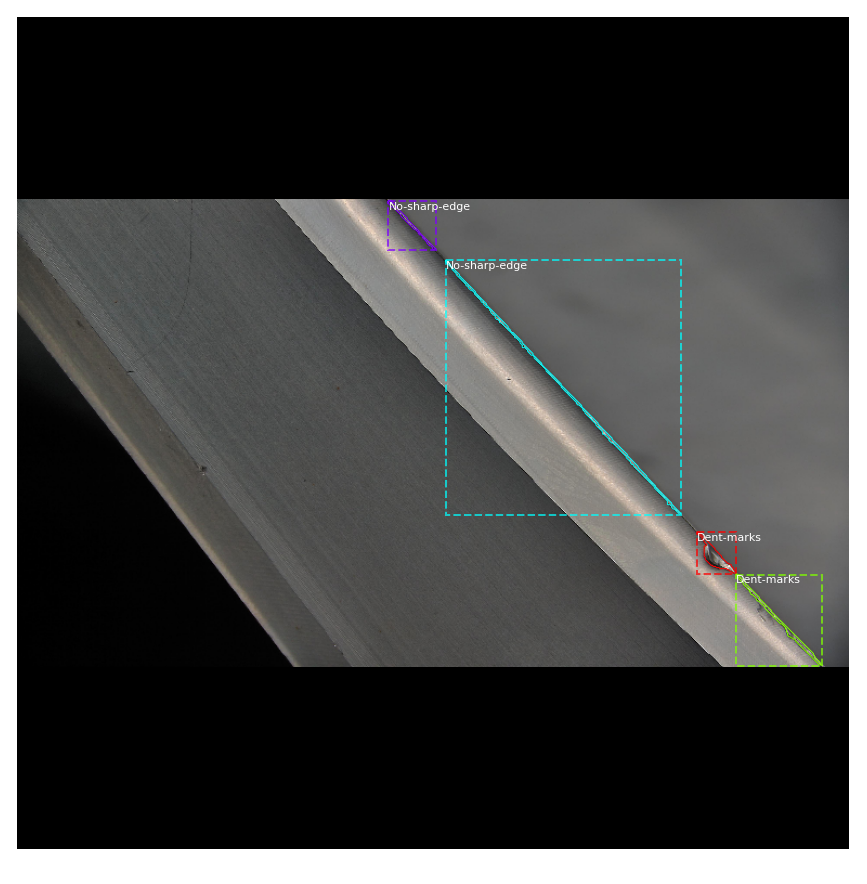

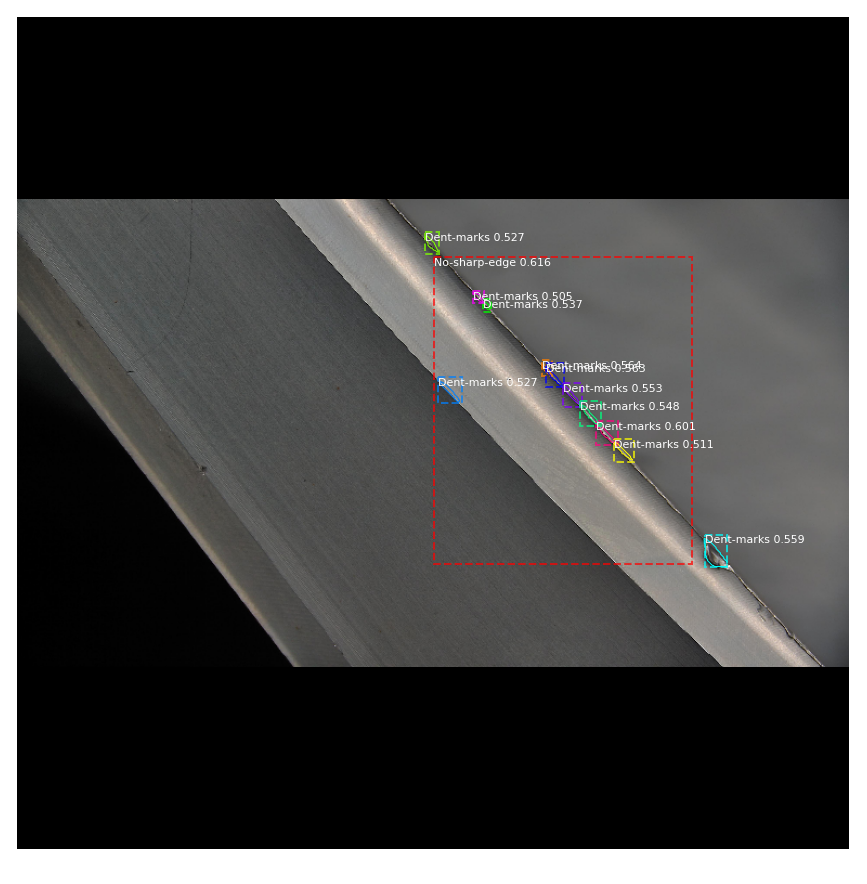

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (21,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (21, 4)               min:    0.00000  max:  744.00000  int32
gt_mask                  shape: (768, 768, 21)        min:    0.00000  max:    1.00000  bool


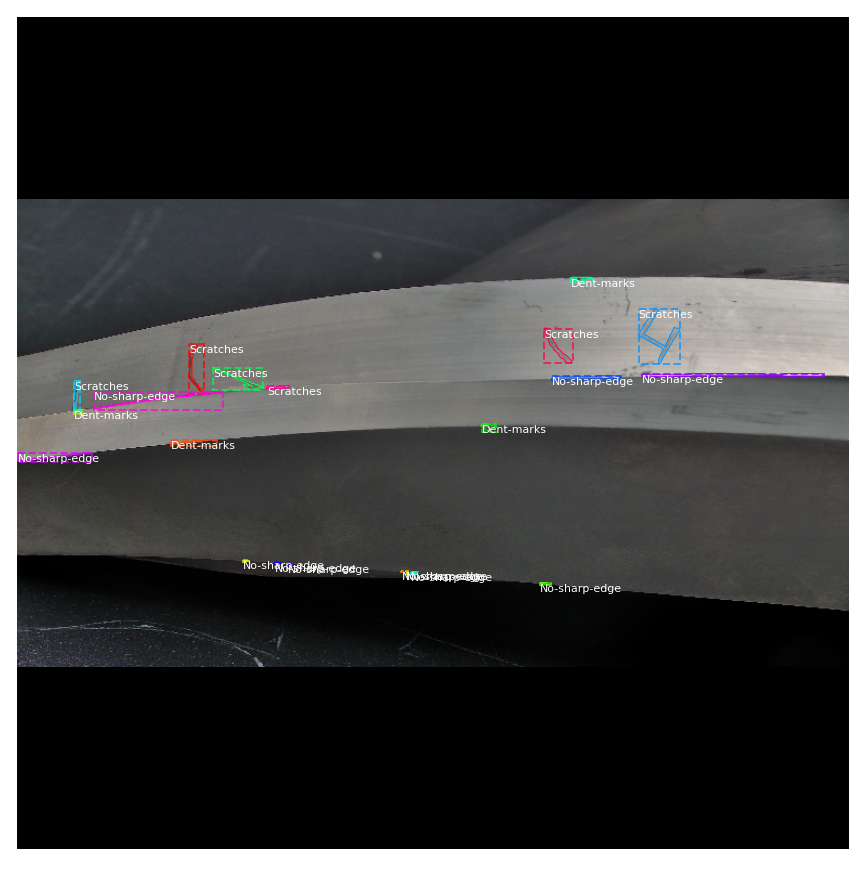

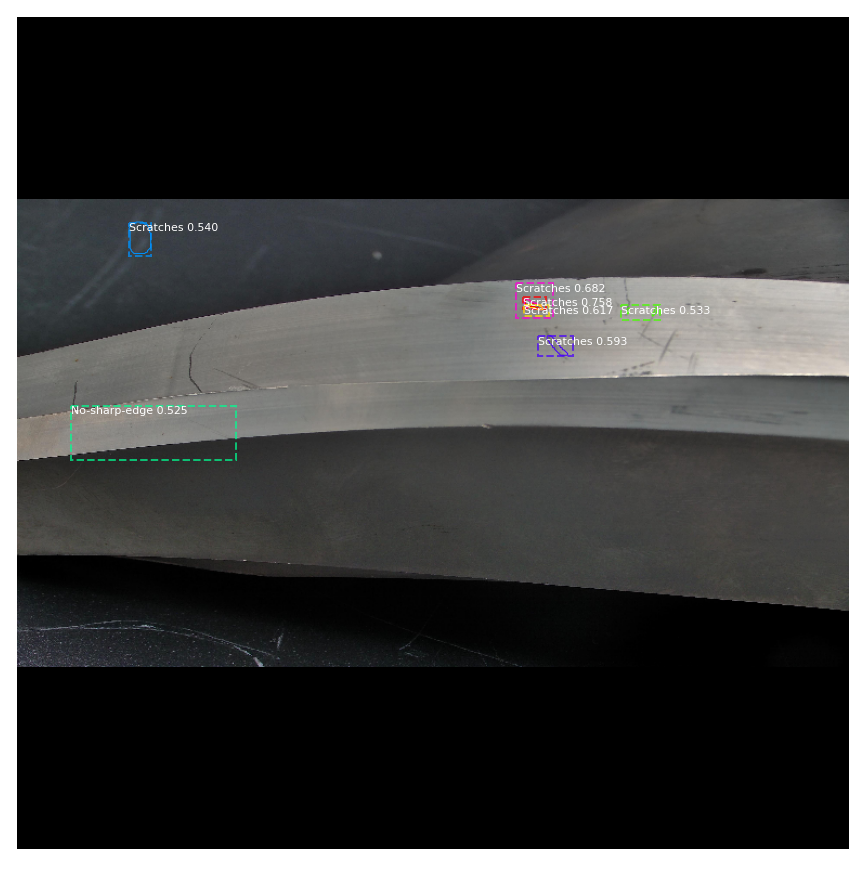

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (7,)                  min:    1.00000  max:    5.00000  int32
gt_bbox                  shape: (7, 4)                min:  169.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 7)         min:    0.00000  max:    1.00000  bool


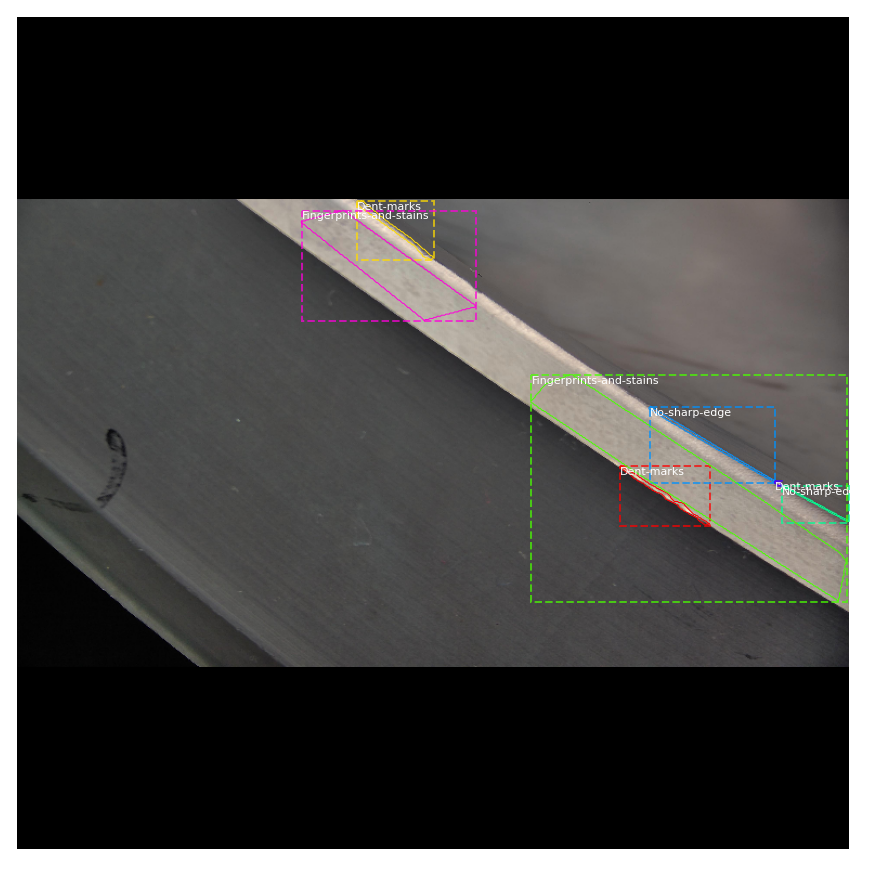

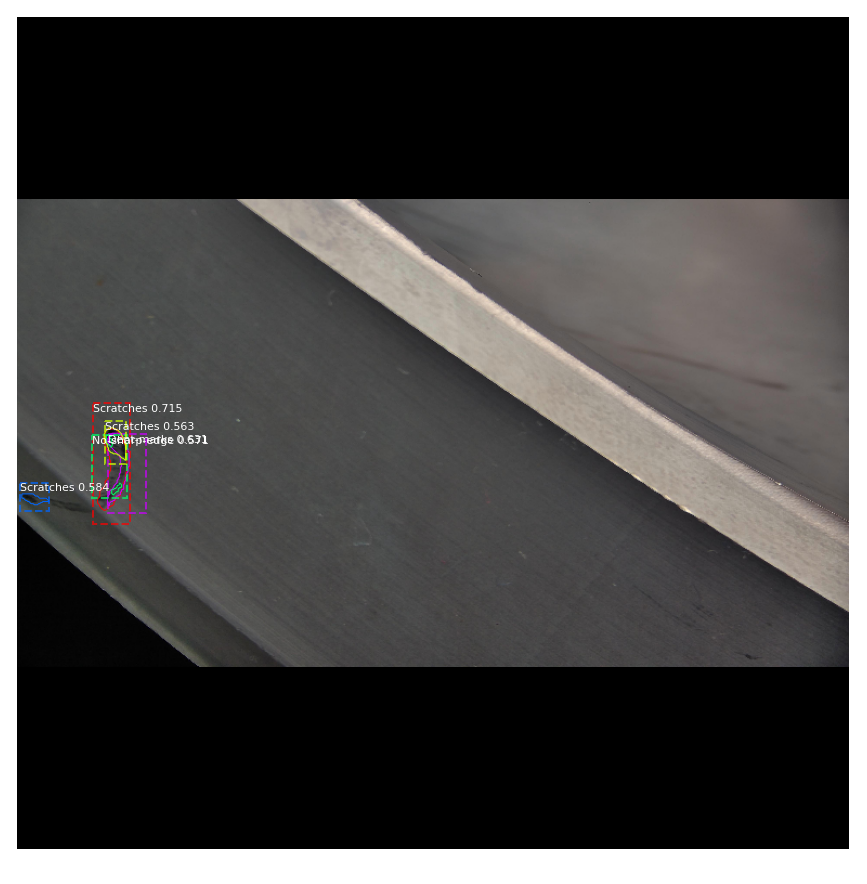

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (10,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (10, 4)               min:    0.00000  max:  740.00000  int32
gt_mask                  shape: (768, 768, 10)        min:    0.00000  max:    1.00000  bool


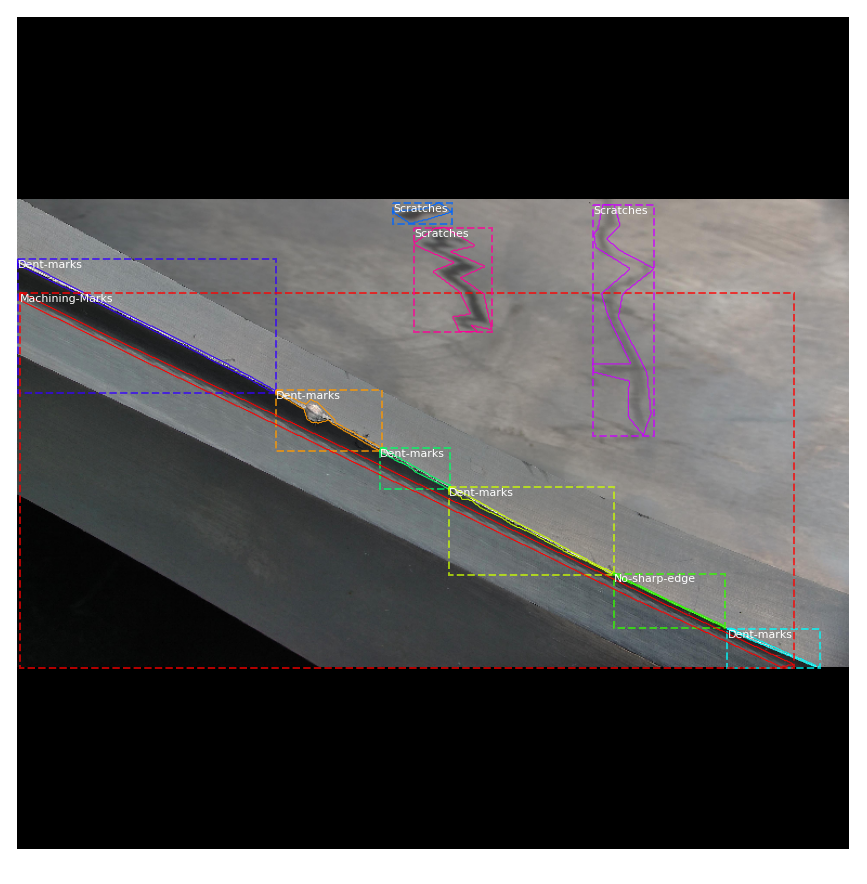

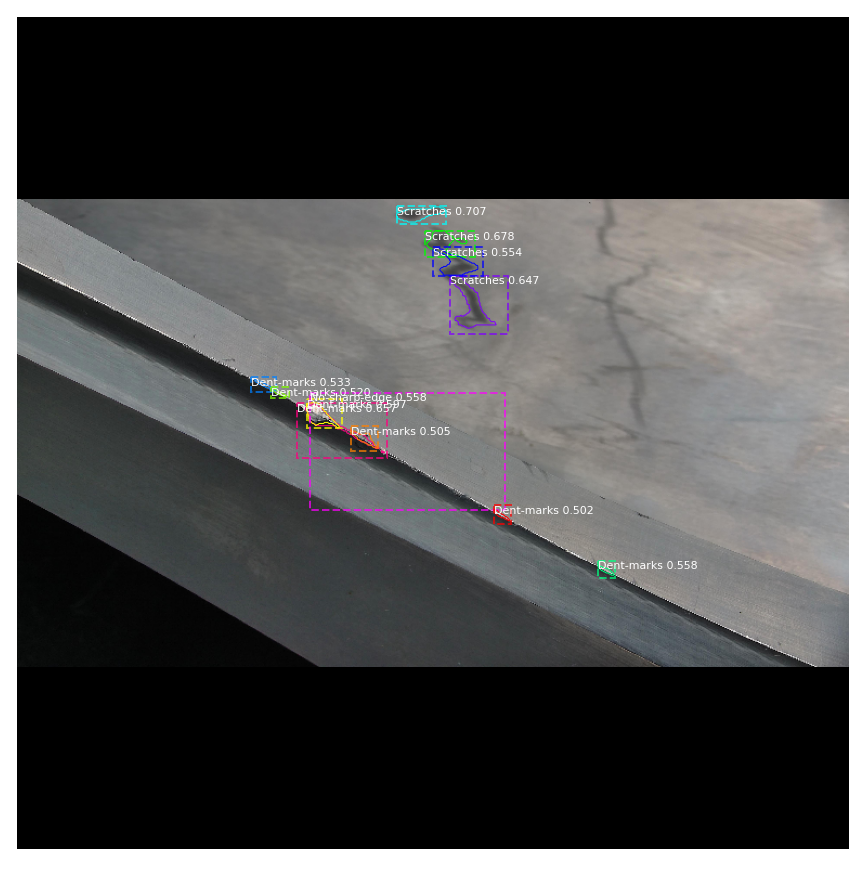

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (20,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (20, 4)               min:  129.00000  max:  767.00000  int32
gt_mask                  shape: (768, 768, 20)        min:    0.00000  max:    1.00000  bool


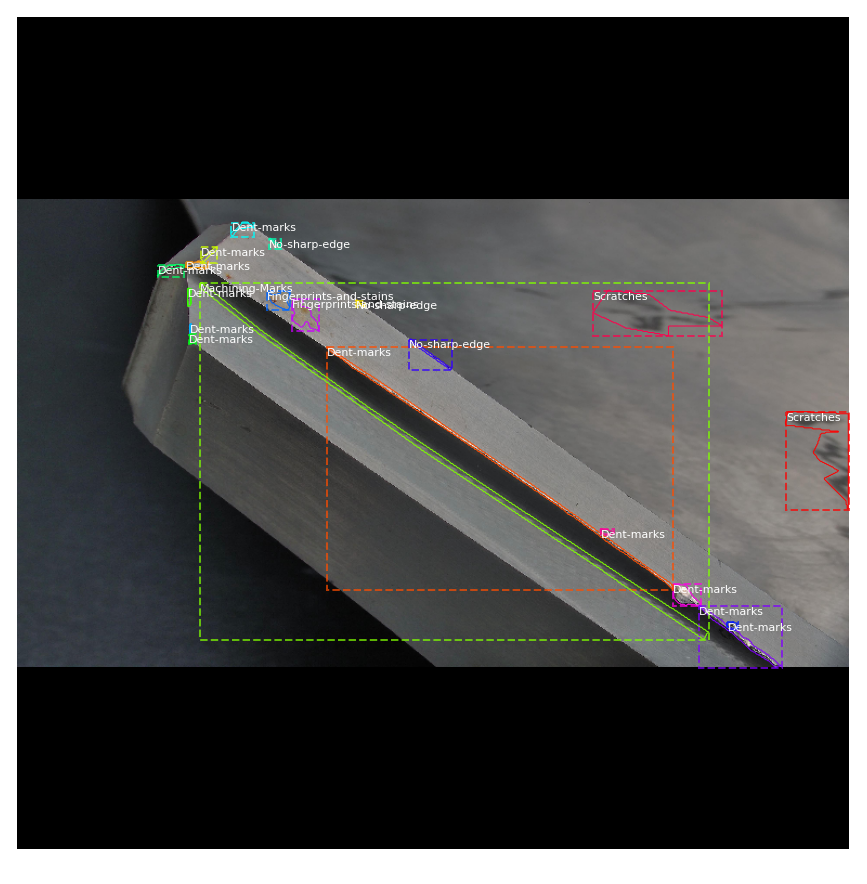

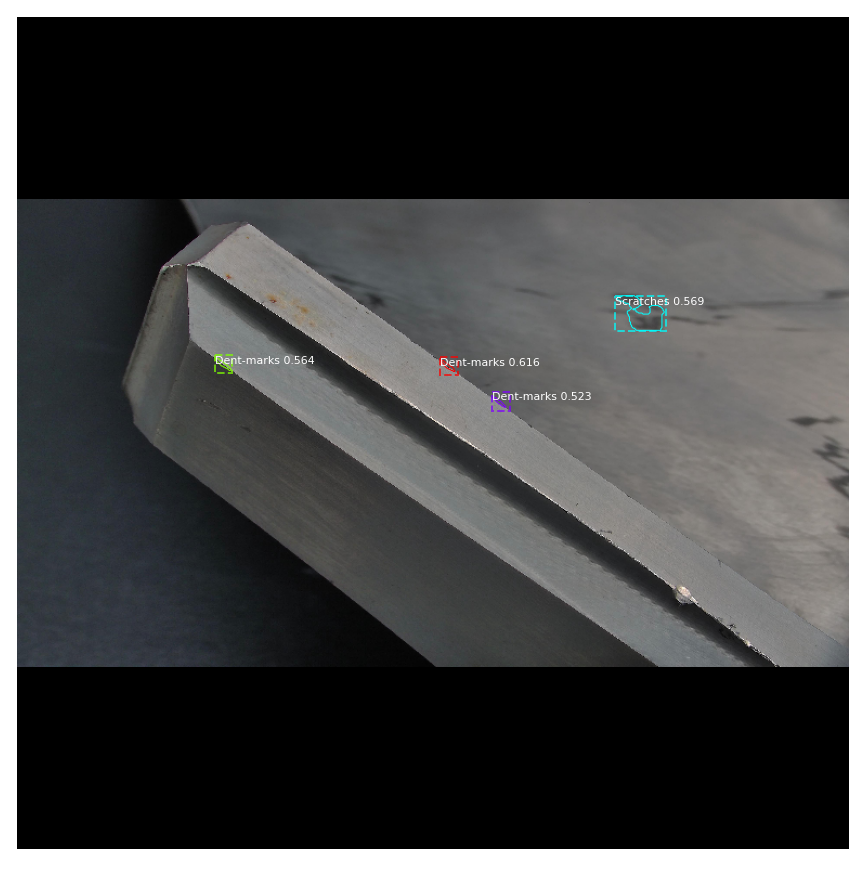

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (16,)                 min:    1.00000  max:    6.00000  int32
gt_bbox                  shape: (16, 4)               min:    1.00000  max:  755.00000  int32
gt_mask                  shape: (768, 768, 16)        min:    0.00000  max:    1.00000  bool


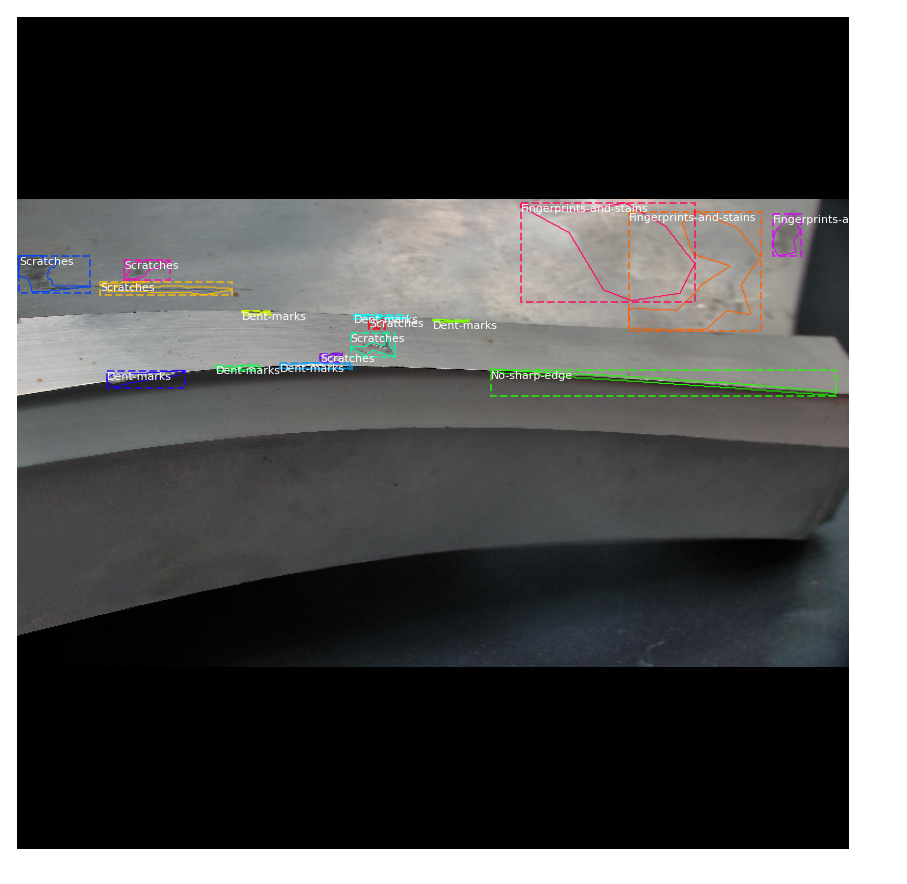

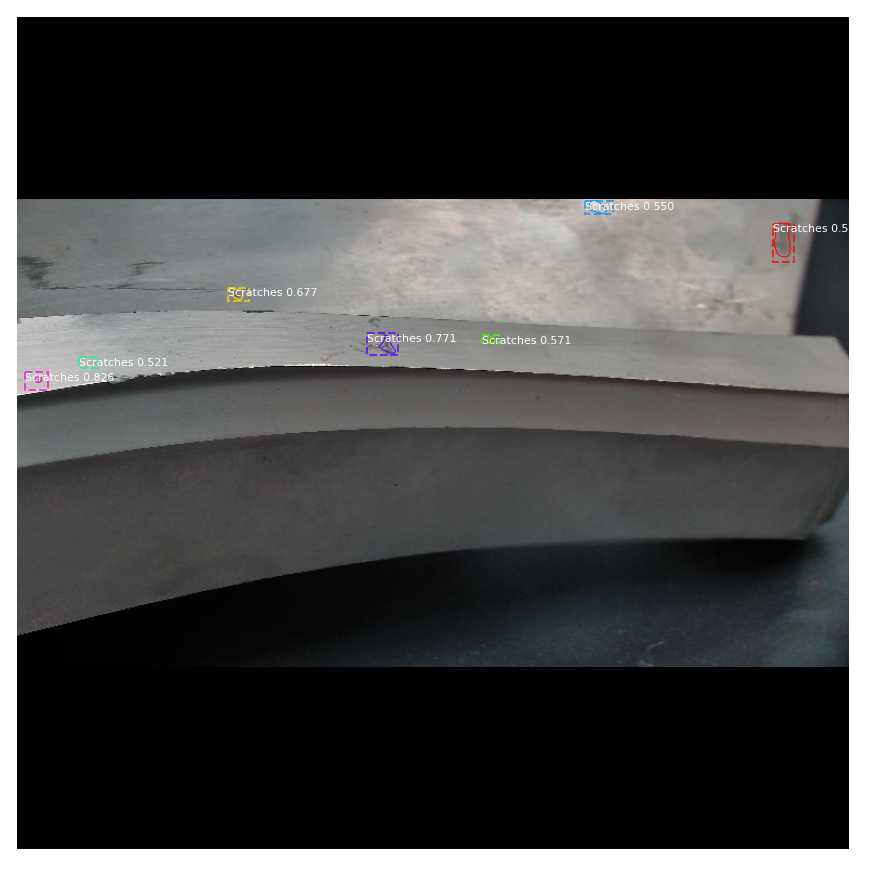

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (5,)                  min:    1.00000  max:    5.00000  int32
gt_bbox                  shape: (5, 4)                min:    0.00000  max:  653.00000  int32
gt_mask                  shape: (768, 768, 5)         min:    0.00000  max:    1.00000  bool


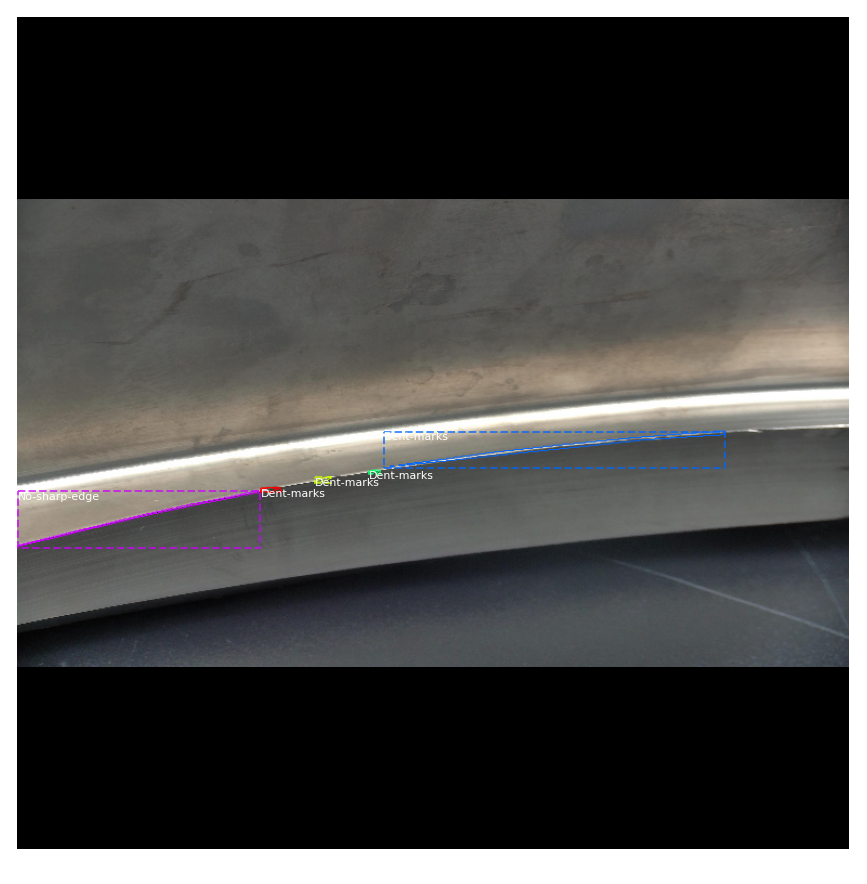

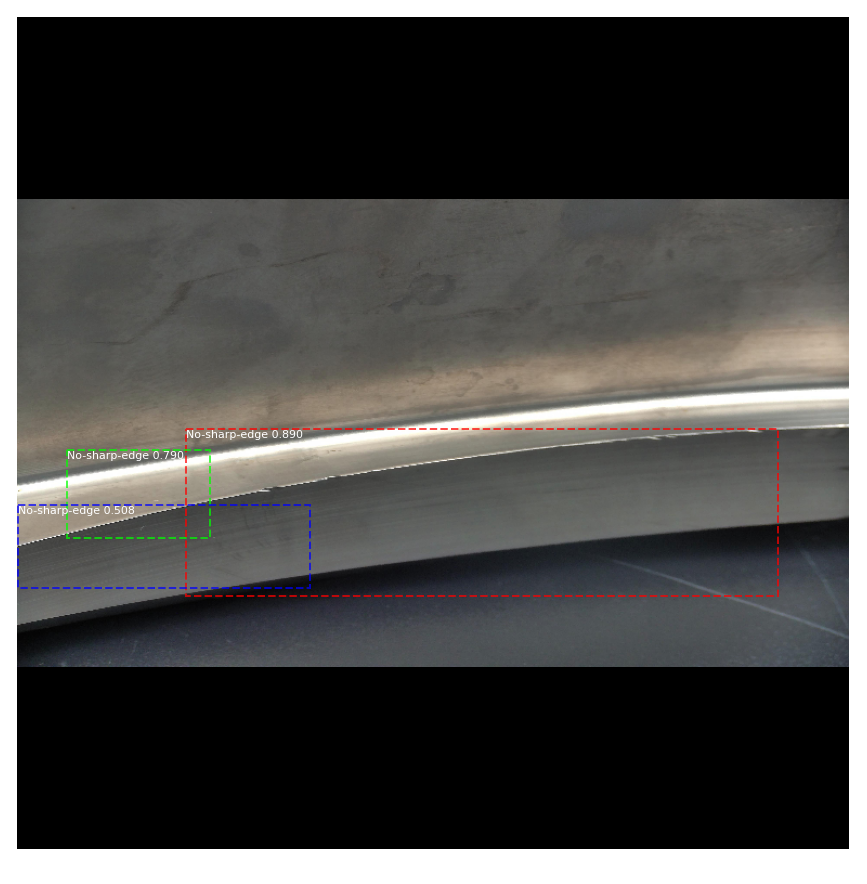

original_image           shape: (768, 768, 3)         min:    0.00000  max:  255.00000  uint8
image_meta               shape: (19,)                 min:    0.00000  max: 3840.00000  float64
gt_class_id              shape: (1,)                  min:    5.00000  max:    5.00000  int32
gt_bbox                  shape: (1, 4)                min:  257.00000  max:  477.00000  int32
gt_mask                  shape: (768, 768, 1)         min:    0.00000  max:    1.00000  bool


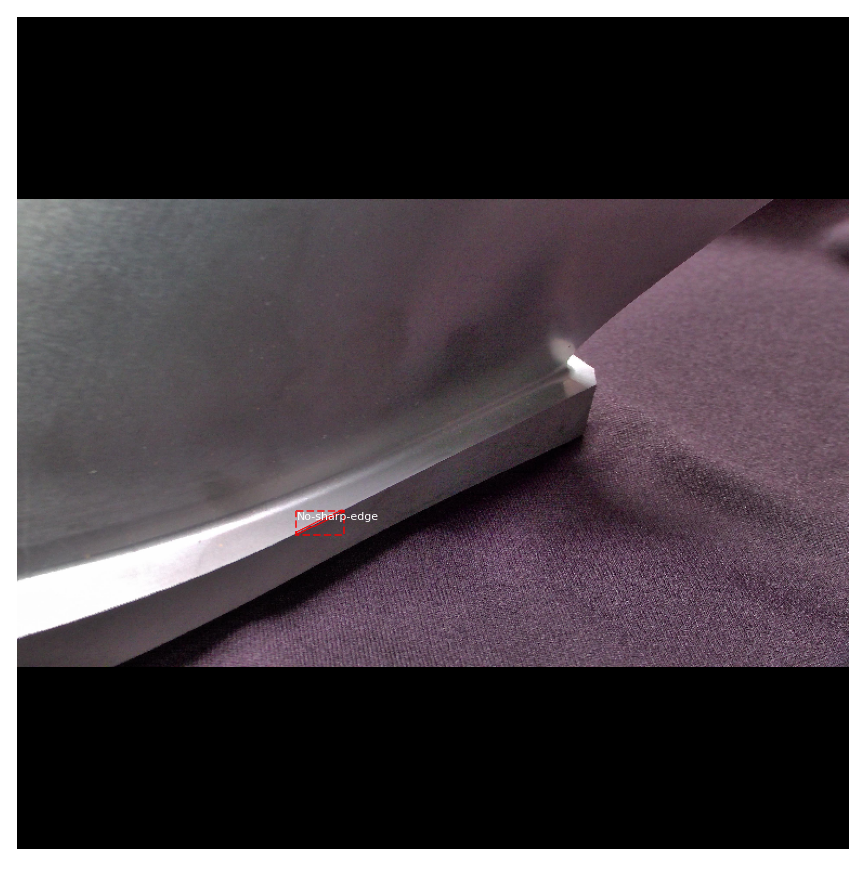

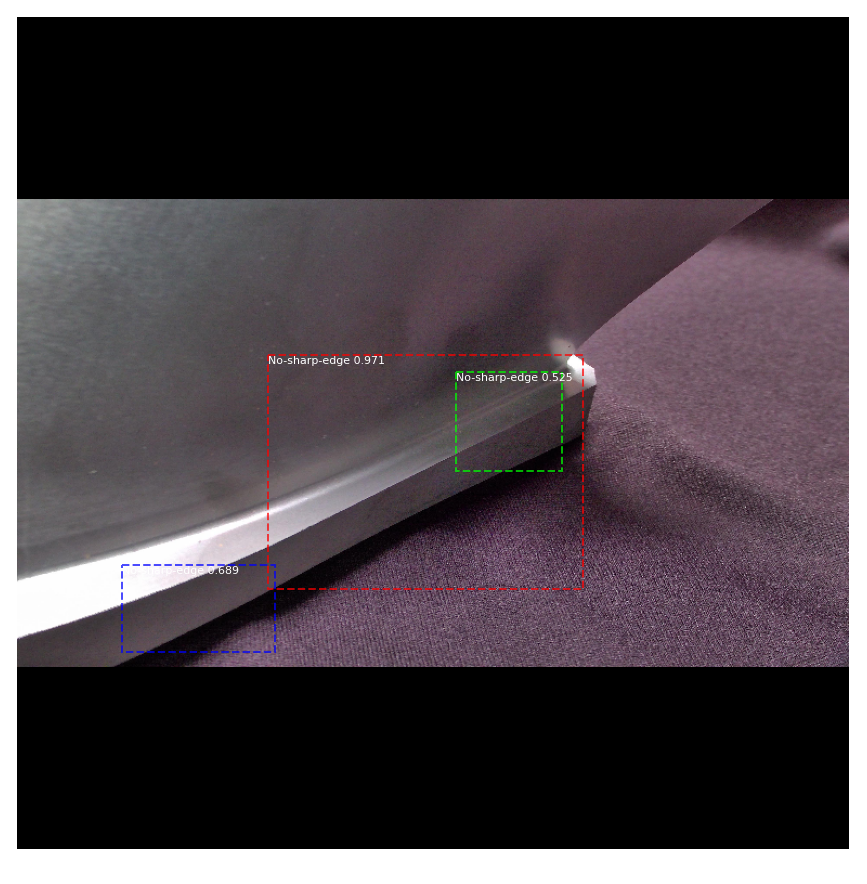

In [15]:
import random
from mrcnn.model import log
for image_id in dataset_val.image_ids:
#     image_id=2
    original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, inference_config, 
                               image_id, use_mini_mask=False)

    log("original_image", original_image)
    log("image_meta", image_meta)
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)
    visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                                dataset_val.class_names, figsize=(16, 16), show_mask=False)
    
    results = model.detect([original_image], verbose=0)
    r = results[0]
    visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                           dataset_val.class_names, r['scores'], figsize=(16, 16), show_mask=False)
    # print(masks)

In [16]:
image_ids = dataset_val.image_ids
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, inference_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    if(np.isnan(AP)==False):
        APs.append(AP)
    else:
        print(image_id)
    
print("AP:", APs)
print("mAP: ", np.mean(APs))

F:\BFL\Mask_RCNN-master-tf1\Mask_RCNN-master\mrcnn\utils.py:734: RuntimeWarning: invalid value encountered in true_divide
  recalls = np.cumsum(pred_match > -1).astype(np.float32) / len(gt_match)


5
AP: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.09803921605149904, 0.0, 0.0, 0.0, 0.07407407462596893, 0.0, 0.0, 0.0, 0.0059523810632526875, 0.03333333432674408, 0.0, 0.0, 0.0, 0.0, 0.0, 0.05, 0.0, 0.0, 0.1666666691501935, 0.0, 0.0, 0.0, 0.0]
mAP:  0.014268855840588608


In [12]:
import cv2
import matplotlib
import matplotlib.pyplot as plt
def get_ax(rows=1, cols=1, size=8):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax